In [123]:
# Load dependencies and data
import copy
import cv2
import json
import os
import random
import matplotlib.pyplot as plt
import numpy as np
import time
import torch

from PIL import Image
import pandas as pd
import torchvision.transforms as transforms

from src.lxrt.tokenization import BertTokenizer
lxmert_tokenizer = BertTokenizer.from_pretrained( "bert-base-uncased", do_lower_case=True)

abs_path = "/home/diego/adv_comp_viz21/lxmert/orig_code/lxmert/"

# LOAD Questions and Image Info
def load_qs_and_image_info():
    imgid2dims = pd.read_csv("/data/diego/adv_comp_viz21/imgfeat/kvqa_imgs_obj36_meta.tsv", 
                             delimiter="\t", names=["img_id","img_w","img_h","features"])
    with open("/data/diego/adv_comp_viz21/kvqa_dataset_with_entity_info_and_ref_imgs_v6cum.json","r") as f:
        kvqa_qs = json.load(f)

    img2groundents = {k:kvqa_qs[k]['NamedEntities'] for k in kvqa_qs}
    return imgid2dims, kvqa_qs, img2groundents

st = time.time()
imgid2dims, kvqa_qs, img2groundents = load_qs_and_image_info()
print("Done. Elapsed:", time.time() - st)

Done. Elapsed: 4.58354377746582


In [502]:
# questions per split
res = []
for i in range(5):
    sp = json.load(open("data/kvqa/test_kvqa"+str(i)+".json"))
    imgs = len(sp)
    qs = sum([ len(q['Questions']) for q in sp])
    res.append([imgs,qs])
res

[[2498, 18697], [2467, 18505], [2514, 18696], [2604, 19248], [2432, 18120]]

In [528]:
#fedff = pd.read_csv("fedfff0924_updated.csv")  #old .. doesn't include plain, link, normal stuff so don't use below
# print(fedff.shape)  #(112182, 29)  =  112182 / 18697 = 6  
# fedff.head(1)

(112182, 29)


,qid,val_ind,model,top1acc,top5acc,top5preds,top5probs,true_ans,num_ents,ent_set,text_expl,tokens,image_expl,bboxes,img_ind,ent_imps,topent_imp,eberts_found,q_hops,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,tokens_whole,text_expl_whole
0,22511_0,0,Plain,0,0,"['Paul Kruger', 'Yes', 'Abraham Lincoln', 'No'...","[-5.373, -5.563, -5.804, -5.951, -5.995]",Henry Labouchère,0,[],"[0.0, 0.9214, 0.5653, 0.9158, 0.9288, 0.8837, ...","['who', 'is', 'the', 'person', 'in', 'the', 'i...","[0.0296, 0.2335, 0.4365, 0.123, 0.0763, 0.1164...","[[0.36644, 0.32435, 0.51792, 0.55949], [0.1491...",22511,[],-1,0,1-hop,1,0,0,0,0,0,0,0,"['[CLS]', 'who', 'is', 'the', 'person', 'in', ...",[0. 0.9214 0.5653 0.9158 0.9288 0.8837 1. ...


In [130]:
 fdf[(fdf.q_hops == "multi-hop")&(fdf.model == "Plain")][0:2]

,qid,img_id,model,linktype,top1acc,top5acc,top5preds,top5probs,true_ans,tokens,num_ents,ent_set,text_expl_bgm,image_expl_bgm,text_expl_trf,image_expl_trf,bboxes,tokens_whole,text_expl_bgm_whole,text_expl_trf_whole,bgm_ent_imps,bgm_topent_imp,bgm_eberts_found,trf_ent_imps,trf_topent_imp,trf_eberts_found,q_hops,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection
20,22511_4,22511,Plain,plain,1,1,"[Europe, North America, South America, Africa,...","[1.508, -2.133, -3.385, -3.836, -3.927]",Europe,"[[CLS], in, which, continent, was, the, person...",0,[],"[0.0, 0.9412, 0.7523000000000001, 0.8772000000...","[0.0046, 0.1165, 0.4927, 0.0882, 0.014, 0.1345...","[0.0, 0.4036, 0.4222, 0.7526, 0.466, 0.3973000...","[0.5468000000000001, 0.171, 0.2987, 0.62330000...","[[0.36644000000000004, 0.32435, 0.51792, 0.559...","[[CLS], in, which, continent, was, the, person...","[0.0, 0.9412, 0.7523000000000001, 0.8772000000...","[0.0, 0.4036, 0.4222, 0.7526, 0.466, 0.3973000...",[],-1,0,[],-1,0,multi-hop,1,0,0,0,0,0,0,0
75,40917_8,40917,Plain,plain,1,1,"[2, 1, English, 3, North America]","[3.768, -3.834, -7.906, -8.031, -8.208]",2,"[[CLS], how, many, people, in, this, image, we...",0,[],"[0.0, 0.222, 0.2275, 0.0325, 0.2033, 0.2115000...","[0.040600000000000004, 0.13970000000000002, 0....","[0.0, 0.0751, 0.0835, 0.0634, 0.048, 0.0681000...","[0.7177, 0.7326, 0.43320000000000003, 0.0728, ...","[[0.47746000000000005, 0.09224, 0.738180000000...","[[CLS], how, many, people, in, this, image, we...","[0.0, 0.222, 0.2275, 0.0325, 0.2033, 0.2115000...","[0.0, 0.0751, 0.0835, 0.0634, 0.048, 0.0681000...",[],-1,0,[],-1,0,multi-hop,1,0,1,0,0,0,1,0


In [133]:
def show_examples_of_type(fedff, qt="spatial", num=10):   #"substraction", "1-hop"
    # show random 
    print("Showing examples of ",qt)
    if qt in ["multi-hop" or "1-hop"]:
        subqs = fedff[(fedff["q_hops"] == qt)&(fedff.model == "Plain")]    
    else:
        subqs = fedff[(fedff[qt] == 1)&(fedff.model == "Plain")]    
    vals = subqs.qid.values    
    random.shuffle(vals)
    for v in vals[0:num]:
        qid, q = v.split("_")
        curq = kvqa_qs[qid]["Questions"][int(q)]
        cura = kvqa_qs[qid]["Answers"][int(q)]        
        capt = kvqa_qs[qid]["wikiCap"]
        #print(kvqa_qs[qid]['Entities'])
        ents = [ t['title'] for t in kvqa_qs[qid]['Entities']]
        print("QID",v, "Q:",curq, "A:",cura, "\n\tENTS:",ents,"\n\tCAPT:", capt) 
    
#show_examples_of_type(fedff, qt="spatial", num=10)
#print("\n\n")
#show_examples_of_type(fedff, qt="subtraction", num=10)

"""
Examples of  spatial
QID 43039_2 Q: Who is to the left of Aamir Ali?      A: Sanjeeda Sheikh
QID 39213_3 Q: Who is to the left of Eddie Polo?     A: Malvina Polo
QID 45086_0 Q: Who is in the left?                   A: Fredrik Reinfeldt
QID 42191_2 Q: Who is to the left of Vladimir Putin? A: Aslambek Aslakhanov
QID 39916_3 Q: Who is to the left of Lee Meriwether? A: Robert Colbert

Showing examples of  subtraction
QID 44920_5 Q: What is the age gap between these two people in image? A: 4 years
QID 19713_1 Q: For how many years did the person in the image live?   A: 39
QID 27874_1 Q: For how many years did the person in the image live?   A: 66
QID 38532_5 Q: Who among the people in the image is the eldest?       A: Person in the center
QID 33922_1 Q: For how many years did the person in the image live?   A: 69
"""

#small improvement .. "boolean", "counting", "comparison",
#largest improvement .. "multi-hop", "multi-relation", and "subtraction"  <-- already shown
#show_examples_of_type(fdf, qt="boolean", num=20)
#print("\n\n")
#show_examples_of_type(fdf, qt="counting", num=20)
#print("\n\n")
#show_examples_of_type(fdf, qt="comparison", num=20)
#print("\n\n")
#show_examples_of_type(fdf, qt="multi-hop", num=20)
#print("\n\n")
show_examples_of_type(fdf, qt="Multi-Relation", num=20)

#CHOOSE 3 OF EACH
print()



Showing examples of  Multi-Relation
QID 32791_4 Q: In which continent was the person in the image born? A: North America 
	ENTS: ['William Windom'] 
	CAPT: William Windom's great-grandson actor WIlliam Windom
QID 21423_3 Q: In which country was the person in the image born? A: United States of America 
	ENTS: ['Zachariah Chandler'] 
	CAPT: Zachariah Chandler Detroit Press and Post - 1880
QID 34883_3 Q: In which country was the person in the image born? A: United States of America 
	ENTS: ['Scott Vincent'] 
	CAPT: Scott Vincent
QID 13546_2 Q: Was the person in the image born after the end of World War II? A: No 
	ENTS: ['Wee Willie Davis'] 
	CAPT: Wee Willie Davis
QID 45781_6 Q: Who among the people in the image were born after the end of World War II? A: Person in the right 
	ENTS: ['F. W. de Klerk', 'Hillary Clinton'] 
	CAPT: De Klerk with US Secretary of State Hillary Clinton in 2012.
QID 28708_2 Q: Was the person in the image born after the end of World War II? A: No 
	ENTS: ['Louis

In [359]:
# KNN EXEPRIMENTs
# confidence by qtype
#knn = json.load(open("../lxmert_gen/Transformer-MM-Explainability-main/knn_kvqa_oracle_1002_1_v7.json"))  #oracle plain res
#knn = json.load(open("../lxmert_gen/Transformer-MM-Explainability-main/knn_kvqa_oracle_noisy_1002_1.json"))  #oracle noisy  
#knn_kvqa_oracle_noisy_1002_1_datawise_normed.json
knn = json.load(open("../lxmert_gen/Transformer-MM-Explainability-main/knn_kvqa_oracle_links_1002_1.json"))#oracle links  <-- NOW

#+ with datawise normalization  ( does worse than without ! )

ks = list(knn.keys())
qid2qtype, qerrs, unq_types = construct_qid2qtypes(kvqa_qs) 
qtype_cols = ["Multi-Relation", "boolean", "Multi-Entity", "comparison", "spatial", "subtraction", "counting", "intersection"]
res = []
# substraction and spatial confidence 
for k in ks:
    cur = knn[k]
    qts = qid2qtype[k]
    incl_sub_spt = True if 'spatial' in qts or 'subtraction' in qts else False
    #res.append([k,cur['top1acc'], cur['top5acc'], cur['top5probs'][0],incl_sub_spt])
    res.append([k,cur['top1acc'], cur['top5acc'], cur['top5probs'][0], cur['top5'],
                cur['knn']['0.95']['top1acc'], cur['knn']['0.95']['top5acc'], cur['knn']['0.95']['top5probs'][0], cur['knn']['0.95']['top5'], 
                cur['naz']['0.95']['top1acc'], cur['naz']['0.95']['top5acc'], cur['naz']['0.95']['top5probs'][0], cur['naz']['0.95']['top5'], 
                cur['nazt']['0.95']['top1acc'], cur['nazt']['0.95']['top5acc'], cur['nazt']['0.95']['top5probs'][0], cur['nazt']['0.95']['top5'], 
                cur['top5'][0] == cur['knn']['0.95']['top5'][0], cur['top5'][0] == cur['naz']['0.95']['top5'][0], 
                cur['knn']['0.95']['top5'][0] == cur['naz']['0.95']['top5'][0], cur['nazt']['0.95']['top5'][0]== cur['naz']['0.95']['top5'][0], incl_sub_spt])
    
#kdf = pd.DataFrame(res, columns=["qid","top1acc","topkacc", "prob","incl_sub_spt"])
kdf = pd.DataFrame(res, columns=["qid","top1acc","topkacc", "prob","top5", 
                                 "knn_top1acc","knn_topkacc", "knn_prob","knn_top5",
                                 "naz_top1acc","naz_topkacc", "naz_prob","naz_top5",
                                 "nazt_top1acc","nazt_topkacc", "nazt_prob","naz_top5",
                                 "same_pred","same_pred_naz","same_pred_knn_naz","same_pred_naz_nazt","incl_sub_spt"])
kdf.head(1)

no question type for  68 out of  183007


,qid,top1acc,topkacc,prob,top5,knn_top1acc,knn_topkacc,knn_prob,knn_top5,naz_top1acc,...,naz_top5,nazt_top1acc,nazt_topkacc,nazt_prob,naz_top5,same_pred,same_pred_naz,same_pred_knn_naz,same_pred_naz_nazt,incl_sub_spt
0,14657_0,0,0,-4.19099,"[John Barrymore, Mary Pickford, Maud Jeffries,...",0,0,0.12717,"[John Barrymore, Mary Pickford, Maud Jeffries,...",0,...,"[Stephen Van Rensselaer, Nance O'Neil, Pee-wee...",0,0,0.92812,"[Stephen Van Rensselaer, Nance O'Neil, Pee-wee...",True,False,False,True,False


In [360]:
#kdf[kdf.incl_sub_spt == True].shape[0], kdf.shape[0] # 3456 out of 18505, 18.67% of questions have spatial or subtraction

def get_stats(df):
    r = [ round(df.top1acc.mean(),4), round(df.topkacc.mean(),4), round(df.prob.mean(),4), round(df[df.top1acc == 1].prob.mean(),4), round(df[df.top1acc == 0].prob.mean(),4),
          round(df.knn_top1acc.mean(),4), round(df.knn_topkacc.mean(),4), round(df.knn_prob.mean(),4), round(df[df.knn_top1acc == 1].knn_prob.mean(),4), round(df[df.knn_top1acc == 0].knn_prob.mean(),4),
          round(df.naz_top1acc.mean(),4), round(df.naz_topkacc.mean(),4), round(df.naz_prob.mean(),4), round(df[df.naz_top1acc == 1].naz_prob.mean(),4), round(df[df.naz_top1acc == 0].naz_prob.mean(),4),
          round(df.nazt_top1acc.mean(),4), round(df.nazt_topkacc.mean(),4), round(df.nazt_prob.mean(),4), round(df[df.nazt_top1acc == 1].nazt_prob.mean(),4), round(df[df.nazt_top1acc == 0].nazt_prob.mean(),4)]
    return r
    
print("ALL", get_stats(kdf))
print("SUB/SPT", get_stats(kdf[kdf.incl_sub_spt == True]))
print("not SUB/SPT", get_stats(kdf[kdf.incl_sub_spt == False]))
### ORACLE
"""              ----------  LM MODEL -----------               ----------  KNN MODEL -----------          ----------  NAZ MODEL -----------          ----------  NAZt MODEL -----------     
              acc@1    @20     conf     when1    when0     acc@1    @20     conf  when1    when0        acc@1    @20     conf   when1   when0      acc@1    @20     conf   when1   when0
        ALL (0.5242, 0.7604,  2.0063,  5.2053, -1.5178    0.5256, 0.7765, 0.6665, 0.9300, 0.3738       0.5138, 0.6595, 0.8850, 0.9675, 0.7975,     0.5151, 0.6595, 0.8485, 0.9603, 0.7297
    SUB/SPT (0.0984, 0.4248, -2.8134, -0.9422, -3.0176    0.1062, 0.4835, 0.1808, 0.3995, 0.1548       0.0822, 0.3411, 0.6965, 0.6774, 0.6982,     0.0819, 0.3411, 0.6053, 0.6305, 0.6031
not SUB/SPT (0.6220, 0.8375,  3.1132,  5.4286, -0.6963    0.622,  0.8438, 0.7782, 0.9508, 0.4933       0.6129, 0.7326, 0.9284, 0.9765, 0.8519,     0.6146, 0.7326, 0.9043, 0.9704, 0.799

for Sub/Spt
using knn:  (0.5256, 0.7714,  2.5655,  5.2389, -0.3968)
"""
#ORACLE
#top1/topk Acc using LM model                    0.52418 0.76039    (using cross output embedding (ie, 1st of text out)
#top1/topk Acc using kNN model with lambda= 0.95 0.52564 0.77655
#top1/topk Acc using naz model                   0.5138, 0.6595
#top1/topk Acc using nazt model with T-1.5       0.5151, 0.6595   

#ORACLE LINKS
"""              ----------  LM MODEL -----------               ----------  KNN MODEL -----------              ----------  NAZ MODEL -----------            ----------  NAZt MODEL -----------     
              acc@1    @20     conf     when1    when0         acc@1    @20     conf  when1    when0          acc@1    @20     conf   when1   when0      acc@1    @20     conf   when1   when0
        ALL [0.5260, 0.7609,  2.1872,  5.5146, -1.5048,       0.5270, 0.7750, 0.6669, 0.9329, 0.3697,        0.5159, 0.6516, 0.8909, 0.9711, 0.8051,    0.5160, 0.6516, 0.8553, 0.9648, 0.7386]
    SUB/SPT [0.0981, 0.4268, -2.7973, -0.9068, -3.0029,       0.1007, 0.4728, 0.1820, 0.4252, 0.1548,        0.0822, 0.3339, 0.6855, 0.7031, 0.6840,    0.0825, 0.3339, 0.5939, 0.6507, 0.5888]
not SUB/SPT [0.6242, 0.8377,  3.3318,  5.7463, -0.6791,       0.6250, 0.8444, 0.7786, 0.9517, 0.4887,        0.6155, 0.7246, 0.9381, 0.9793, 0.8719,    0.6155, 0.7246, 0.9154, 0.9745, 0.8207]
"""
#ORACLE LINKS
#top1/top5 Acc using kNN model with lambda= 0.95 0.52705 0.77503
#top1/top5 Acc using naz model with lambda= 0.95 0.51586 0.65161
#top1/top5 Acc using nazt model with lambda= 0.95 0.51597 0.65161


#ORACLE NOISY
"""              ----------  LM MODEL -----------               ----------  KNN MODEL -----------              ----------  NAZ MODEL -----------            ----------  NAZt MODEL -----------     
              acc@1    @20     conf     when1    when0         acc@1    @20     conf  when1    when0          acc@1    @20     conf   when1   when0      acc@1    @20     conf   when1   when0
         ALL [0.5286, 0.7611,  1.7516,  4.8916, -1.7688,      0.5285, 0.7755, 0.6519, 0.9237, 0.3470,        0.5122, 0.6605, 0.8523, 0.9601, 0.7391,    0.5139, 0.6605, 0.8158, 0.9531, 0.6705]
    #SUB/SPT [0.0966, 0.4222, -2.9099, -1.0642, -3.1074,      0.0978, 0.4757, 0.1674, 0.3922, 0.1430,        0.0813, 0.3218, 0.5704, 0.6122, 0.5666,    0.0845, 0.3218, 0.4845, 0.5696, 0.4766]
#not SUB/SPT [0.6277, 0.8390,  2.8222,  5.1022, -1.0228,      0.6274, 0.8443, 0.7633, 0.9427, 0.4606,        0.6111, 0.7383, 0.9172, 0.9707, 0.8328,    0.6125, 0.7383, 0.8918, 0.9653, 0.7758]
"""
#ORACLE NOISY
#top1/top5 Acc using kNN model with lambda= 0.95 0.52851 0.77547
#top1/top5 Acc using naz model with lambda= 0.95 0.51219 0.66047
#top1/top5 Acc using nazt model with lambda= 0.95 0.51392 0.66047

#TODO neither of the naz have datawise normalization though so we could see if that helps?
print()

ALL [0.526, 0.7609, 2.1872, 5.5146, -1.5048, 0.527, 0.775, 0.6669, 0.9329, 0.3697, 0.5159, 0.6516, 0.8909, 0.9711, 0.8051, 0.516, 0.6516, 0.8553, 0.9648, 0.7386]
SUB/SPT [0.0981, 0.4268, -2.7973, -0.9068, -3.0029, 0.1007, 0.4728, 0.182, 0.4252, 0.1548, 0.0822, 0.3339, 0.6855, 0.7031, 0.684, 0.0825, 0.3339, 0.5939, 0.6507, 0.5888]
not SUB/SPT [0.6242, 0.8377, 3.3318, 5.7463, -0.6791, 0.625, 0.8444, 0.7786, 0.9517, 0.4887, 0.6155, 0.7246, 0.9381, 0.9793, 0.8719, 0.6155, 0.7246, 0.9154, 0.9745, 0.8207]



In [363]:
#Q1: how good could I have done falling back to interpolated vs just knn based on conf and on type

#Q1.A  use interpolated knn res for all Sub / Str only
def construct_sub_spt(t='knn'):
    knn_sub_spt = []
    for k in ks:
        cur = knn[k]
        qts = qid2qtype[k]
        if 'spatial' in qts or 'subtraction' in qts:
            knn_sub_spt.append([k,cur[t]['0.95']['top1acc'], cur[t]['0.95']['top5acc'], cur[t]['0.95']['top5probs'][0],True])
        else:
            knn_sub_spt.append([k,cur['top1acc'], cur['top5acc'], cur['top5probs'][0],False])
    sdf = pd.DataFrame(knn_sub_spt, columns=["qid","top1acc","topkacc", "prob","incl_sub_spt"])
    print(round(sdf[sdf.incl_sub_spt == False].shape[0] / 18505,5)  , "% of questions use LM. "
           "Using ",t," res on sub/spt:", round(sdf.top1acc.mean(),4), round(sdf.topkacc.mean(),4), 
            round(sdf.prob.mean(),4), round(sdf[sdf.top1acc == 1].prob.mean(),4), round(sdf[sdf.top1acc == 0].prob.mean(),4))
                            #                                                           acc@1    @20     conf     when1    when0  
                            #                            sing 100% preds with LM we get 0.5242, 0.7604, 2.0063,  5.2053, -1.5178
construct_sub_spt(t='knn')  #0.81324 % of questions use LM. Using  knn  res on sub/spt: 0.5256  0.7714  2.5655   5.2389  -0.3968
construct_sub_spt(t='naz')  #0.81324 % of questions use LM. Using  naz  res on sub/spt: 0.5213  0.7448  2.6502   5.2792  -0.2129
construct_sub_spt(t='nazt') #0.81324 % of questions use LM. Using  nazt res on sub/spt: 0.5211  0.7448  2.6448   5.2878  -0.2311

"""
#oracle
                                                           acc@1    @20     conf     when1    when0  
                            sing 100% preds with LM we get 0.5242, 0.7604  2.0063   5.2053, -1.5178
0.81324 % of questions use LM. Using  knn  res on sub/spt: 0.5256  0.7714  2.5655   5.2389  -0.3968
0.81324 % of questions use LM. Using  naz  res on sub/spt: 0.5213  0.7448  2.6502   5.2792  -0.2129
0.81324 % of questions use LM. Using  nazt res on sub/spt: 0.5211  0.7448  2.6448   5.2878  -0.2311

                                                           acc@1    @20     conf     when1    when0  
#oracle links
                            sing 100% preds with LM we get 0.5260  0.7609  2.1872  5.5146  -1.5048
0.81324 % of questions use LM. Using  knn  res on sub/spt: 0.5265  0.7695  2.7436  5.5563  -0.3834
0.81324 % of questions use LM. Using  naz  res on sub/spt: 0.5230  0.7436  2.8376  5.5983  -0.1893
0.81324 % of questions use LM. Using  nazt res on sub/spt: 0.5230  0.7436  2.8205  5.5963  -0.2236

#oracle noisy
                            sing 100% preds with LM we get 0.5286  0.7611  1.7516   4.8916  -1.7688
0.81324 % of questions use LM. Using  knn  res on sub/spt: 0.5288  0.7711  2.3264   4.9395  -0.6059
0.81324 % of questions use LM. Using  naz  res on sub/spt: 0.5257  0.7424  2.4016   4.9725  -0.4478
0.81324 % of questions use LM. Using  nazt res on sub/spt: 0.5263  0.7424  2.3856   4.9663  -0.4816
"""


#xxx NOW DO TEMPERATURE SCALING FOR NAZ EXPERIMENTS (probably) ( nazt ) 
#xxx Read section 5 of knn LM paper and maybe experiment with last LM and last OBJ
#xxx NOW do experiments on oracle_noisy and oracle_links too 
#NEXT: Do NAZ experiment using datawise normalization  <-- Check results but it looks bad.. do knn stuff for splits 0,2,3,4 
#then right up thoughts/table and move to okvqa 

#Then Do OKVQA stuff (tables, knn experiments, etc )
#and Explanaiability humna setup
#and write up
print()

0.81324 % of questions use LM. Using  knn  res on sub/spt: 0.5265 0.7695 2.7436 5.5563 -0.3834
0.81324 % of questions use LM. Using  naz  res on sub/spt: 0.523 0.7436 2.8376 5.5983 -0.1893
0.81324 % of questions use LM. Using  nazt  res on sub/spt: 0.523 0.7436 2.8205 5.5963 -0.2236



In [364]:
#Q1.B  use interpolated knn res for all qs with less than -1.5 conf ( average of wrong case )
def generate_knn_conf(t='knn', thresh = -1.5178 ):
    knn_conf = []
    for k in ks:
        cur = knn[k]
        qts = qid2qtype[k]
        if cur['top5probs'][0] < thresh:
            knn_conf.append([k,cur[t]['0.95']['top1acc'], cur[t]['0.95']['top5acc'], cur[t]['0.95']['top5probs'][0],True])
        else:
            knn_conf.append([k,cur['top1acc'], cur['top5acc'], cur['top5probs'][0],False])
    cdf = pd.DataFrame(knn_conf, columns=["qid","top1acc","topkacc", "prob","orig_low_conf"])
    print("For thresh",thresh,": ",round(cdf[cdf.orig_low_conf == False].shape[0] / 18505,4), "% of questions use LM",
          "using interpolated",t,"res for low conf:", round(cdf.top1acc.mean(),5), round(cdf.topkacc.mean(),4), 
           round(cdf.prob.mean(),4), round(cdf[cdf.top1acc == 1].prob.mean(),4), round(cdf[cdf.top1acc == 0].prob.mean(),4))

threshs = [-7, -5, -3, -1.5178, 0, 1.5, 3, 5,10]  
#threshs = [-.1,-.05,0,.05,.1]
for t in threshs:
    generate_knn_conf(t='knn', thresh = t)        # ** thresh of 0 gives best results for Interpolated KNN goes  from 52.418 to 52.597    oracle
                                                  #For thresh -1.5178 use LM using interpolated knn res goes from 0.5286 to 0.52883 oracle noisy
                                                  #For thresh 0 0.5260 to 0.52732 oracle links
print("\n")

#threshs = [v/10 for v in range(-40,-20,1)]  #between -4 and -2
for t in threshs:
    generate_knn_conf(t='naz', thresh = t)        # ** thresh of -3 gives best results for Interpolated KNN goes from 52.418 to 52.553   oracle
                                                  #For thresh -5 :  use LM using interpolated naz res goes from 0.5286 to 0.52878 oracle noisy
                                                  #For thresh 1.5:  use LM using interpolated naz res goes from 0.5260 to 0.52602 oracle links
print("\n")
for t in threshs:
    generate_knn_conf(t='nazt', thresh = t)        # ** thresh of -3 gives best results for Interpolated KNN goes from 52.418 to 52.553   oracle
                                                   #For thresh -5 : use LM using interpolated nazt res goes from 0.5286 to 0.52878 0.7613 oracle noisy
                                                   ##For thresh -5: use LM using interpolated nazt res goes from 0.5260 to 0.52602 oracle links

For thresh -7 :  1.0 % of questions use LM using interpolated knn res for low conf: 0.52597 0.7609 2.1872 5.5146 -1.5048
For thresh -5 :  0.9599 % of questions use LM using interpolated knn res for low conf: 0.52597 0.7617 2.4056 5.5151 -1.0445
For thresh -3 :  0.7867 % of questions use LM using interpolated knn res for low conf: 0.5264 0.769 3.1052 5.5352 0.4041
For thresh -1.5178 :  0.702 % of questions use LM using interpolated knn res for low conf: 0.52678 0.7744 3.3301 5.5585 0.8466
For thresh 0 :  0.64 % of questions use LM using interpolated knn res for low conf: 0.52732 0.7749 3.4013 5.5869 0.9569
For thresh 1.5 :  0.5223 % of questions use LM using interpolated knn res for low conf: 0.52705 0.775 3.4307 5.6148 0.9891
For thresh 3 :  0.4701 % of questions use LM using interpolated knn res for low conf: 0.52705 0.775 3.3643 5.5366 0.9365
For thresh 5 :  0.381 % of questions use LM using interpolated knn res for low conf: 0.52705 0.775 3.0863 5.1294 0.803
For thresh 10 :  0.0412 

In [365]:
#Q1.C How often does KNN and LM pred differ?

#oracle plain
#print(kdf.same_pred.value_counts())          #True: 17537 and False:  968  so  94.77% of the time its the same prediction using knn or LM
#print(kdf.same_pred_naz.value_counts())      #True: 11518 and False: 6987  so  62.24% of the time its the same prediction using naz or LM
#print(kdf.same_pred_knn_naz.value_counts())  #True: 12504 and False: 6001  so  67.57% of the time its the same prediction using naz or knn
#print(kdf.same_pred_naz_nazt.value_counts()) #True: 18299 and False:  206  so  98.89% of the time its the same prediction using naz or nazt

#oracle links
print(kdf.same_pred.value_counts())          #True: 17488 and False: 1017  so  94.50% of the time its the same prediction using knn or LM
print(kdf.same_pred_naz.value_counts())      #True: 11827 and False: 6678  so  63.91% of the time its the same prediction using naz or LM
print(kdf.same_pred_knn_naz.value_counts())  #True: 12717 and False: 5788  so  65.77% of the time its the same prediction using naz or knn
print(kdf.same_pred_naz_nazt.value_counts()) #True: 18310 and False:  195  so  98.95% of the time its the same prediction using naz or nazt


#oracle noisy
#print(kdf.same_pred.value_counts())          #True: 17686 and False:  819  so  95.57% of the time its the same prediction using knn or LM
#print(kdf.same_pred_naz.value_counts())      #True: 11398 and False: 7107  so  61.59% of the time its the same prediction using naz or LM
#print(kdf.same_pred_knn_naz.value_counts())  #True: 12062 and False: 6443  so  65.18% of the time its the same prediction using naz or knn
#print(kdf.same_pred_naz_nazt.value_counts()) #True: 18159 and False:  346  so  98.13% of the time its the same prediction using naz or nazt

print()

True     17488
False     1017
Name: same_pred, dtype: int64
True     11827
False     6678
Name: same_pred_naz, dtype: int64
True     12717
False     5788
Name: same_pred_knn_naz, dtype: int64
True     18310
False      195
Name: same_pred_naz_nazt, dtype: int64



In [352]:
"""
def load_train_npy(split_num = "1", use_lm = "ebert", ent_set = "oracle"):
    train_embeds_file = "train_embeds_"+split_num+"_"+use_lm+"_"+ent_set+".npy"
    print("Loading ", train_embeds_file)
    train_vecs = np.load("../lxmert_gen/Transformer-MM-Explainability-main/"+train_embeds_file)
    train_vecs_2d = train_vecs.squeeze()
    return train_vecs_2d

def datasetwise_normalize(train_vecs_2d, mu, sig, eps=.0000001):
    return (train_vecs_2d - mu)/(sig + eps)

train_vecs_2d = load_train_npy(split_num = "1", use_lm = "ebert", ent_set = "oracle")
#train_vecs_2d.shape  #(127118, 768)
mu = train_vecs_2d.mean(axis=0)
sig = train_vecs_2d.std(axis=0)

train_vecs_2d_normed = datasetwise_normalize(train_vecs_2d, mu, sig, eps=.0000001)
print(train_vecs_2d[0,0:10])
print(mu[0:10])
print(sig[0:10])
print(train_vecs_2d_normed[0,0:10]), 
"""
print()

Loading  train_embeds_1_ebert_oracle.npy
[-0.05413454 -0.80247533  0.80277866 -0.7073541   0.41469407  0.87919694
  0.62600815 -0.6880637  -0.8012805  -0.03924897]
[ 0.18544942 -0.1326548   0.42431888  0.07692131  0.43321338 -0.16095148
  0.01852676 -0.15089983 -0.01052198 -0.04103366]
[0.5187991  0.47493717 0.3980956  0.42709208 0.36289316 0.61991394
 0.5142243  0.55548    0.59785366 0.637362  ]
[-0.46180478 -1.4103348   0.95067537 -1.8363142  -0.05103239  1.6778913
  1.1813546  -0.96702623 -1.322662    0.00280012]


(None,)

In [213]:
#following is just for a table
#plain and capt are each a list for the 5 split files  ( no sep stuff since it gave comparable results )
#oracle, sep13 and yasu2 are list for 5 splits, each with plain/links/noisy numbers
                            #sp0    1      2      3       4    avg
recs = {          "plain":[47.27, 47.54, 47.34, 48.35, 47.18, 47.54],
                   "capt":[49.84, 50.43, 50.66, 51.05, 49.25, 50.25],   
        "sep13":{ "plain":[49.72, 50.05, 50.33, 51.09, 50.11, 50.26], 
                  "links":[50.29, 50.24, 49.64, 50.86, 50.63, 50.33],
                  "noisy":[50.08, 50.78, 50.72, 51.38, 50.91, 50.77]},        
        "yasu2":{ "plain":[50.05, 50.67, 50.25, 51.58, 49.28, 50.37],           
                  "links":[50.11, 50.28, 50.73, 50.27, 50.73, 50.42],
                  "noisy":[51.10, 50.24, 50.25, 51.34, 50.53, 50.69]},
        "oracle":{"plain":[52.20, 52.64, 52.70, 53.22, 52.50, 52.65], 
                  "links":[52.83, 52.60, 51.92, 53.44, 52.60, 52.68],
                  "noisy":[53.01, 52.86, 52.37, 53.58, 52.34, 52.83]}
       }
    
#what is the difference between the two evaluates!
#I'm not running the test with --max_len 50 !  <-- test that
    
#NOTE: the last oracle experiment will be incorrectly written out as kvqa_oracle_noisy_1005_3  when it should be "links"  !!
    
# make script to run tests on all 3 * 3 * 4 experiments ( 36 ) to fill in above numbers

tes_runs1to4 = [
    [["kvqa_yasu2_0930_1.txt","kvqa_yasu2_1004_2.txt","kvqa_yasu2_1001_3.txt","kvqa_yasu2_1001_4.txt","kvqa_yasu2_1001_4.txt"],
    ["kvqa_yasu2links_1001_1.txt","kvqa_yasu2links_1001_2.txt","kvqa_yasu2links_1002_2.txt","kvqa_yasu2links_1002_3.txt","kvqa_yasu2links_1002_4.txt"],
    ["kvqa_yasu2noisy_1002_1.txt","kvqa_yasu2noisy_1003_2.txt","kvqa_yasu2noisy_1003_3.txt","kvqa_yasu2noisy_1004_4.txt"]],

    [["kvqa_sep13_3_1001_1.txt", "kvqa_sep13_3_1001_2.txt", "kvqa_sep13_3_1001_3.txt", "kvqa_sep13_3_1001_4.txt"],
    ["kvqa_sept13_fewkb_links_1001_1.txt", "kvqa_sept13_fewkb_links_1001_2.txt", "kvqa_sept13_fewkb_links_1001_3.txt", "kvqa_sept13_fewkb_links_1001_4.txt"],
    ["kvqa_sept13_fewkb_1001_1.txt", "kvqa_sept13_fewkb_1001_2.txt", "kvqa_sept13_fewkb_1001_3.txt", "kvqa_sept13_fewkb_1001_4.txt"]],

    [["kvqa_oracle_1002_1.txt", "kvqa_oracle_1002_2.txt", "kvqa_oracle_1002_3.txt", "kvqa_oracle_1002_4.txt"],
    ["kvqa_oracle_links_1002_1.txt", "kvqa_oracle_links_1002_2.txt", "kvqa_oracle_links_1005_3.txt", "kvqa_oracle_links_1002_4.txt"],
    ["kvqa_oracle_noisy_1002_1.txt", "kvqa_oracle_noisy_1002_2.txt", "kvqa_oracle_noisy_1002_3.txt", "kvqa_oracle_noisy_1002_4.txt"]]  
]

for k in recs:
    if k in ["plain","capt"]:
        print(k, round(np.mean(recs[k][0:5]),4))
    else:
        print(k, "plain", round(np.mean(recs[k]["plain"][0:5]),4))
        print(k, "links", round(np.mean(recs[k]["links"][0:5]),4))
        print(k, "noisy", round(np.mean(recs[k]["noisy"][0:5]),4))

#next steps make table
#show conf
#write up in AAAI template

plain 47.536
capt 50.246
sep13 plain 50.26
sep13 links 50.332
sep13 noisy 50.774
yasu2 plain 50.366
yasu2 links 50.424
yasu2 noisy 50.692
oracle plain 52.652
oracle links 52.678
oracle noisy 52.832


In [215]:
rows = [["Plain", "-", 47.27, 47.54, 47.34, 48.35, 47.18, 47.54],
        ["Capt",  "-", 49.84, 50.43, 50.66, 51.05, 49.25, 50.25],   
        ["NERagro","plain", 49.72, 50.05, 50.33, 51.09, 50.11, 50.26], 
        ["NERagro","links", 50.29, 50.24, 49.64, 50.86, 50.63, 50.33],
        ["NERagro","noisy", 50.08, 50.78, 50.72, 51.38, 50.91, 50.77],        
        ["NERper", "plain", 50.05, 50.67, 50.25, 51.58, 49.28, 50.37],           
        ["NERper", "links", 50.11, 50.28, 50.73, 50.27, 50.73, 50.42],
        ["NERper", "noisy", 51.10, 50.24, 50.25, 51.34, 50.53, 50.69],
        ["Oracle","plain", 52.20, 52.64, 52.70, 53.22, 52.50, 52.65], 
        ["Oracle","links", 52.83, 52.60, 51.92, 53.44, 52.60, 52.68],
        ["Oracle","noisy", 53.01, 52.86, 52.37, 53.58, 52.34, 52.83]]
d = pd.DataFrame(rows,columns=["Model","Type","Split 1","Split 2","Split 3","Split 4","Split 5","Avg"])
print(d.to_latex(index=False))

\begin{tabular}{llrrrrrr}
\toprule
  Model &  Type &  Split 1 &  Split 2 &  Split 3 &  Split 4 &  Split 5 &   Avg \\
\midrule
  Plain &     - &    47.27 &    47.54 &    47.34 &    48.35 &    47.18 & 47.54 \\
   Capt &     - &    49.84 &    50.43 &    50.66 &    51.05 &    49.25 & 50.25 \\
NERagro & plain &    49.72 &    50.05 &    50.33 &    51.09 &    50.11 & 50.26 \\
NERagro & links &    50.29 &    50.24 &    49.64 &    50.86 &    50.63 & 50.33 \\
NERagro & noisy &    50.08 &    50.78 &    50.72 &    51.38 &    50.91 & 50.77 \\
 NERper & plain &    50.05 &    50.67 &    50.25 &    51.58 &    49.28 & 50.37 \\
 NERper & links &    50.11 &    50.28 &    50.73 &    50.27 &    50.73 & 50.42 \\
 NERper & noisy &    51.10 &    50.24 &    50.25 &    51.34 &    50.53 & 50.69 \\
 Oracle & plain &    52.20 &    52.64 &    52.70 &    53.22 &    52.50 & 52.65 \\
 Oracle & links &    52.83 &    52.60 &    51.92 &    53.44 &    52.60 & 52.68 \\
 Oracle & noisy &    53.01 &    52.86 &    52.37 &    

In [622]:
# LOAD EXPERIMENTS AND ENTITY SETS  ( 11/02 )

print()

import time
split = 0
def get_ent_dicts(linktype="plain"):
    epath = abs_path + "data/kvqa/"
    if linktype == "plain":
        ospans_dict = json.load(open(epath + "new_kvqa_q_caps_ents0502.json"))  
        yasu2_spans_dict = json.load(open(epath + "kvqa_ent_spans_yasu2_0916.json"))
        sep13_few_spans_dict = json.load(open(abs_path + "data/kvqa/kvqa_ent_spans_sept13_3corb.json"))
    elif linktype == "links":
        ospans_dict = json.load(open(epath + "kvqa_oracle_ent_spans_with_wikis0923.json"))
        yasu2_spans_dict = json.load(open(epath + "yasu_links_ent_spans_with_wikis0926.json"))
        sep13_few_spans_dict = json.load(open(epath + "kvqa_sep13_few_links_ent_spans0926.json"))
    elif linktype == "noisy":
        ospans_dict = json.load(open(epath + "kvqa_oracle_noisy_ent_spans_with_wikis0923.json"))  
        yasu2_spans_dict = json.load(open(epath + "yasu_noisy_ent_spans_with_wikis0926a.json"))
        sep13_few_spans_dict = json.load(open(epath + "kvqa_ent_spans_sept13_fewkbcor.json"))

    return ospans_dict, sep13_few_spans_dict, yasu2_spans_dict
    
#only doing explanation analysis on split 0
    
def get_kvqa_perturb_records(split=0, with_sep= False, linktype="plain"):
    # linktype in ["plain", "links", "noisy"]
    
    p = "../lxmert_gen/Transformer-MM-Explainability-main/experiments/"
    print("Getting Explanation records for KVQA Split:", split, "using Sep=",with_sep, "Link type", linktype)
    st = time.time()
    if split == 0:                                                                      #   top1   top5     qs   
        plain_r = json.load(open(p+"kvqa_plain_multi_0927_0.json"))                        # [47.27, 66.71, 18697,  ] MT        
        if linktype == "plain":
            eb_sep13_few = json.load(open(p+"kvqa_sep13_3_multi_0927_0.json"))             # [49.72, 67.67  # MT
        elif linktype == "noisy": 
            eb_sep13_few = json.load(open(p+"kvqa_ebert_0_sept13_fewkb_multi_0927.json"))  # [50.08, 67.66,  # MT
        elif linktype == "links":
            eb_sep13_few = json.load(open(p+"kvqa_sept13_fewkb_links_0925_0_val25.json"))  # [50.29, 67.99   #MT 

        if with_sep == False:
            capt_r = json.load(open(p+"kvqa_capt_multi_0927_0.json"))                     # [49.84, 67.66,   MT
            if linktype == "plain":
                yasu2_records = json.load(open(p+"kvqa_ebert_0_yasu2_0927_multi.json"))    # [50.05, 67.75   MT
                ebert_r =  json.load(open(p+"kvqa_ebert_0_oracle_val28_multi.json"))       # [52.2 , 68.89   MT
            elif linktype == "links":
                yasu2_records = json.load(open(p+"kvqa_yasu2_links_0925_0_val25.json"))    # [50.11, 67.93  links MT
                ebert_r = json.load(open(p+"kvqa_oracle_links_multi_0927_0.json"))         # [52.83, 69.6   #oracle links MT
            elif linktype == "noisy":
                yasu2_records = json.load(open(p+"kvqa_yasu2_noisy_0925_0_val25.json"))    # [51.10, 68.56  noisy MT
                ebert_r = json.load(open(p+"kvqa_oracle_noisy_0927_0_val27.json"))         # [53.01, 69.4,,  #noisy MT           
                
        if with_sep == True:
            capt_r = json.load(open(p+"kvqa_capt_sep_0925_0_val25.json"))                  # [49.1 , 67.32, ]   #  -.7
            yasu2_records = json.load(open(p+"kvqa_yasu2_links_sep_0925_0_val25.json"))    # [50.48, 68.04, ]   #  +.8
            #ebert_r = json.load(open(p+"kvqa_oracle_links_sep_0925_0_val25.json"))        # [52.50, 69.42,]   # -.33
            ebert_r = json.load(open(p+"kvqa_oracle_links_sep_multi_0926_0.json"))         #same as above but MT
        
        return plain_r, capt_r, ebert_r, eb_sep13_few, yasu2_records
    else:
        print(split, " not supported at the moment ")
  
import time
st = time.time()

###### IMPORTANT SET THESE FOR GLOBAL USE
split = 0
with_sep = False
#########################################

plain_res = get_kvqa_perturb_records(split=0, with_sep = with_sep, linktype = "plain")
plain_spans = get_ent_dicts(linktype="plain")

links_res = get_kvqa_perturb_records(split=0, with_sep = with_sep, linktype = "links")
links_spans = get_ent_dicts(linktype="links")

noisy_res = get_kvqa_perturb_records(split=0, with_sep = with_sep, linktype = "noisy")
noisy_spans = get_ent_dicts(linktype="noisy")

print("Done. Elapsed:", time.time() - st)  #34sec


Getting Explanation records for KVQA Split: 0 using Sep= False Link type plain
Getting Explanation records for KVQA Split: 0 using Sep= False Link type links
Getting Explanation records for KVQA Split: 0 using Sep= False Link type noisy
Done. Elapsed: 23.607597827911377


In [187]:
#SCRATCH
#sf = links_res[3]
#sf = noisy_res[3]
#k = list(sf.keys())
#k[0], sf[k[0]]  transformer_att is in sept13 few links
#k[0], sf[k[0]]  

In [623]:
# WAITING on PLAIN / CAPT multi

#now construct df ( have multi flag ), join tokens/expl
# load every variant "plain", "noisy", "links"  and add column with that delineation  
#    ( for sep13_few, yasu2 and oracle .. for Plain and CAPT there are no variants .. )
#    ( for sep13_few "plain" use sep13_3,  "noisy" = sep13_few  and "links" = fewkb_links
# make columns for Explanations:  text_expl_bgm, image_expl_bgm  and text_expl_trf  , image_expl_trf

import string

# 3. Check attribution is correct.  Make sure you join wordpieces before showing end results
#    Not much difference from using SEP over APPEND

def convert_to_original_length(tokens, t1expl):
    text = tokens[0]
    new_toks = [tokens[0]]
    new_expl = [t1expl[0]]                
    for i, x in enumerate(tokens[1:]):
        if x in string.punctuation:
            text += '' + x
            new_expl.extend([t1expl[i+1]])
            new_toks.extend([tokens[i+1]])
        else:
            if x.startswith('##'):
                text += '' + x.replace('##', '')
                new_expl[-1] += t1expl[i+1]
                new_toks[-1] = new_toks[-1] + x.replace('##', '')
            else:
                text += ' ' + x
                new_expl.extend([t1expl[i+1]])
                new_toks.extend([tokens[i+1]])
                
    # renormalize new_expl ?
    new_expl /= np.max(new_expl)
    assert(len(new_toks) == len(new_expl)) 
    return text, new_toks, new_expl
    

def join_tokens_expl_for_all_qs(fedff, to_show = 3):
    fedff['tokens_whole'] = [[] for _ in range(fedff.shape[0])]
    fedff['text_expl_bgm_whole'] = [[] for _ in range(fedff.shape[0])]
    fedff['text_expl_trf_whole'] = [[] for _ in range(fedff.shape[0])]
    for i in range(fedff.shape[0]):
        cur = fedff.loc[i]
        
        #t1 = ['[CLS]'] + eval(cur.tokens) + ['[SEP]']
        if type(cur.tokens) != list:
            t1 = eval(cur.tokens)
            t1explb = eval(cur.text_expl_bgm)
            t1explt = eval(cur.text_expl_trf)
        else:
            t1 = cur.tokens
            t1explb = cur.text_expl_bgm
            t1explt = cur.text_expl_trf
            
        if t1[0] != '[CLS]':
            t1 = ['[CLS]'] + t1 + ['[SEP]']
            
        if i < to_show:
            print("\n",i, "WAS",len(t1), t1 , "\n",len(t1explb), t1explb, "\n", len(t1explt), t1explt) 

        t1_text, t1_tokens, t1expl_new_bgm = convert_to_original_length(t1, t1explb)
        t1expl_new_trf = []
        if len(t1explt) > 0:
            _, _, t1expl_new_trf = convert_to_original_length(t1, t1explt)
        fedff.at[i,'tokens_whole'] = t1_tokens
        fedff.at[i,'text_expl_bgm_whole'] = t1expl_new_bgm
        fedff.at[i,'text_expl_trf_whole'] = t1expl_new_trf
        if i < to_show:
            print("\n",i,"NOW", len(t1_tokens), t1_tokens, "\n", len(t1expl_new), t1expl_new)
    return fedff


def construct_df(plain_res, plain_spans, links_res, links_spans, noisy_res, noisy_spans):
        
    linktypes = [ [plain_res, plain_spans, "plain"], [links_res, links_spans, "links"], [noisy_res, noisy_spans, "noisy"]]
    pd_rows = []

    for lt in linktypes:
        ltname = lt[2]
        plain_records, capt_records, ebert_records, ebert_sep13_few, yasu2 = lt[0]
        oracle_spans_dict, sep13_few_spans_dict, yasu2_spans_dict = lt[1]
    
        for ind, k in enumerate(plain_records):
            imgid = k.split("_")[0]
            q = int(k.split("_")[1])
            cur_dict = {'Plain':plain_records[k], 'CAPT':capt_records[k],
                        'EBERT-sep13_few': ebert_sep13_few[k], 
                        'Yasu2': yasu2[k], 
                        'EBERT-oracle':ebert_records[k]}

            cur_ents = {'Plain':[], 'CAPT':[],
                        'EBERT-sep13_few':sep13_few_spans_dict[imgid]["ents_found"],
                        'Yasu2': yasu2_spans_dict[imgid]["ents_found"], 
                        'EBERT-oracle':oracle_spans_dict[imgid]["ents_found"]}

            true_ans = plain_records[k]['true_ans']
            capt = kvqa_qs[imgid]['wikiCap']
            oracle_capt = oracle_spans_dict[imgid]['wikiCap_new']
            sent = kvqa_qs[imgid]['Questions'][q]

            for i in cur_dict:
                v = cur_dict[i]

                if "tokens" not in v:
                    tokens = []            
                    if i == "Plain":                    
                        tokens = lxmert_tokenizer.tokenize(sent)                     
                    elif i in ["CAPT"]:
                        tokens = lxmert_tokenizer.tokenize(sent+" " + capt)
                    elif i in ["EBERT-oracle", 'EBERT-sep13_few', 'Yasu2']:  
                        # never used
                        tokens = lxmert_tokenizer.tokenize(sent+" " + oracle_capt)
                else:
                    tokens = v["tokens"]            

                #add ent_sets and explanations as well here
                try:
                    bgm_txt_ep, bgm_img_ep, trf_txt_ep, trf_img_ep = [],[],[],[]
                    if 'expl_methods' in v:                        
                        bgm_txt_ep = v['expl_methods']['ours_no_lrp']['text_expl']
                        bgm_img_ep = v['expl_methods']['ours_no_lrp']['image_expl']
                        trf_txt_ep = v['expl_methods']['transformer_att']['text_expl']
                        trf_img_ep = v['expl_methods']['transformer_att']['image_expl']
                    else:
                        #single Generic BiModal expl
                        bgm_txt_ep = v['text_expl']
                        bgm_img_ep = v['image_expl']
                        
                    pd_rows.append([k,imgid, i, ltname, round(v['top1acc'],3), v['top5acc'], 
                                    v['top5'],[round(b,3) for b in v['top5probs']],
                                    true_ans, tokens, len(cur_ents[i]), cur_ents[i], 
                                    bgm_txt_ep, bgm_img_ep, trf_txt_ep, trf_img_ep, v['bboxes']])

                except Exception as e:
                    print(k,ind,i,v,e)
                    import sys
                    sys.exit()

    df = pd.DataFrame(pd_rows, columns=["qid","img_id","model","linktype","top1acc","top5acc", 
                                        "top5preds","top5probs","true_ans","tokens", "num_ents","ent_set",
                                        "text_expl_bgm","image_expl_bgm","text_expl_trf","image_expl_trf","bboxes"]) 
    
    df = join_tokens_expl_for_all_qs(df, to_show = 0)
    
    print("Top1 and Top5 ACC numbers for All Models")
    for lt in linktypes:
        print("\nTop1 and Top5 ACC numbers for All Models - Linktype:",lt[2])
        for m in list(cur_dict.keys()):
            print(m,round(df[(df.model == m)&(df.linktype == lt[2])].top1acc.mean(),4))
            #round(df[(df.model == m)&(df.linktype == lt[2])].top5acc.mean(),4))
    
    return df

st = time.time()
print("Constructing DF with_sep: ", with_sep)
df = construct_df(plain_res, plain_spans, links_res, links_spans, noisy_res, noisy_spans)
print("Done. Elapsed:", time.time() - st)  #102.

Constructing DF with_sep:  False
Top1 and Top5 ACC numbers for All Models

Top1 and Top5 ACC numbers for All Models - Linktype: plain
Plain 0.4727
CAPT 0.4984
EBERT-sep13_few 0.4972
Yasu2 0.5005
EBERT-oracle 0.522

Top1 and Top5 ACC numbers for All Models - Linktype: links
Plain 0.4727
CAPT 0.4984
EBERT-sep13_few 0.5029
Yasu2 0.5011
EBERT-oracle 0.5283

Top1 and Top5 ACC numbers for All Models - Linktype: noisy
Plain 0.4727
CAPT 0.4984
EBERT-sep13_few 0.5008
Yasu2 0.511
EBERT-oracle 0.5301
Done. Elapsed: 103.38267636299133


In [624]:
df[(df.model == "EBERT-sep13_few")&(df.qid == '22511_0')]  #at this point everything is fine 

#df[(df.model == "Plain")&(df.linktype == "plain")&(df.img_id == "40917")].qid.value_counts()  #==> null
df[df.img_id == "40917"].qid.value_counts()   #ok it loaded properly!  so it means that the big json got saved incorrectly somehow!   

# HERE LOOK AT RE-SAVING BIG JSON ( and identifying beforehand why it saved incorrectly )

40917_0     15
40917_1     15
40917_2     15
40917_3     15
40917_4     15
40917_5     15
40917_6     15
40917_7     15
40917_8     15
40917_9     15
40917_10    15
40917_11    15
40917_12    15
40917_13    15
40917_14    15
40917_15    15
Name: qid, dtype: int64

In [625]:
# add ebert importance
def return_importance_by_word(txt_exps, toks):
    #print("Call Return by Imp",len(txt_exps), len(toks), txt_exps, toks)
    text_attrs = [ (toks[a],b) for a, b in enumerate(txt_exps) ] 
    text_attrs_sorted = sorted(text_attrs, key=lambda pair: pair[1], reverse=True)
    return text_attrs_sorted

"""
def get_qs_for_ind(img_ind='22511',till=-1):
    eo = df[(df.model == "EBERT-oracle")&(df['img_ind'] == img_ind)]
    eks = eo.index.values[0:eo.shape[0]]
    for i, ei in enumerate(eks):
        cur = eo.loc[ei]
        q_ind = int(cur.qid.split("_")[1])
        if i == 0:
            print(img_ind, "Q:", kvqa_qs[cur.img_ind]['Questions'][q_ind] + " **Caption: " +kvqa_qs[cur.img_ind]['wikiCap'],"\n")

        imp = return_importance_by_word(cur.text_expl, cur.tokens)
        print(ei, cur.qid, len(cur.tokens) == len(cur.text_expl))
        print(cur.tokens[0:till] )
        print("\t",[(a[0],round(a[1],2)) for a in imp[0:till]])
"""

def add_importance_of_eberts(df, token_col = 'tokens', text_expl_col = 'text_expl', to_show = 100):
    edf = copy.deepcopy(df)
    inds = edf.index.values
    loc = []
    topent_pos = [] 
    for ii, i in enumerate(inds):
        res = []
        cur = edf.loc[i]        
        cur_tokens, top_pos, imp = [], -1, []   
        if cur.num_ents > 0:
            cur_tokens = cur[token_col]
            if len(cur_tokens) == 1:
                cur_tokens = cur_tokens[0]
            imp = return_importance_by_word(cur[text_expl_col ], cur_tokens)
            for k, im in enumerate(imp):
                if '<ebert>' in im[0]:                    
                    res.append([k,im[0],im[1]])
        loc.append(res)
        if res != []:
            top_pos = res[0][0]
        topent_pos.append(top_pos)

        if ii < to_show:
            if cur.model == "Plain":
                print("")
            print("POST", i, cur.model, cur.qid, len(res), "eberts found with top at", top_pos, "of", 
                  len(imp), "****" if top_pos < 5 and top_pos > -1 else "") #, cur_tokens, "\n", imp)
        
    expl = "bgm" if "bgm" in text_expl_col else "trf"
    print("ADDING ", expl)
    edf[expl + "_ent_imps"] = loc
    edf[expl + "_topent_imp"] = topent_pos
    edf[expl + "_eberts_found"] = [ len(l) for l in loc ]
    return edf

st = time.time()
edf = add_importance_of_eberts(df, token_col = 'tokens_whole', text_expl_col = 'text_expl_bgm_whole', to_show=10)
print(edf.columns)
fdf = add_importance_of_eberts(edf, token_col = 'tokens_whole', text_expl_col = 'text_expl_trf_whole', to_show=10)
print(fdf.columns)
print("Done. Elapsed:", time.time() - st)  #86 secs
fdf.head(1)


POST 0 Plain 22511_0 0 eberts found with top at -1 of 0 
POST 1 CAPT 22511_0 0 eberts found with top at -1 of 0 
POST 2 EBERT-sep13_few 22511_0 1 eberts found with top at 8 of 14 
POST 3 Yasu2 22511_0 1 eberts found with top at 8 of 14 
POST 4 EBERT-oracle 22511_0 1 eberts found with top at 12 of 14 

POST 5 Plain 22511_1 0 eberts found with top at -1 of 0 
POST 6 CAPT 22511_1 0 eberts found with top at -1 of 0 
POST 7 EBERT-sep13_few 22511_1 1 eberts found with top at 15 of 18 
POST 8 Yasu2 22511_1 1 eberts found with top at 14 of 18 
POST 9 EBERT-oracle 22511_1 1 eberts found with top at 16 of 18 
ADDING  bgm
Index(['qid', 'img_id', 'model', 'linktype', 'top1acc', 'top5acc', 'top5preds',
       'top5probs', 'true_ans', 'tokens', 'num_ents', 'ent_set',
       'text_expl_bgm', 'image_expl_bgm', 'text_expl_trf', 'image_expl_trf',
       'bboxes', 'tokens_whole', 'text_expl_bgm_whole', 'text_expl_trf_whole',
       'bgm_ent_imps', 'bgm_topent_imp', 'bgm_eberts_found'],
      dtype='obje

,qid,img_id,model,linktype,top1acc,top5acc,top5preds,top5probs,true_ans,tokens,num_ents,ent_set,text_expl_bgm,image_expl_bgm,text_expl_trf,image_expl_trf,bboxes,tokens_whole,text_expl_bgm_whole,text_expl_trf_whole,bgm_ent_imps,bgm_topent_imp,bgm_eberts_found,trf_ent_imps,trf_topent_imp,trf_eberts_found
0,22511_0,22511,Plain,plain,0,0,"[Paul Kruger, Yes, Abraham Lincoln, No, John C...","[-5.373, -5.563, -5.804, -5.951, -5.995]",Henry Labouchère,"[[CLS], who, is, the, person, in, the, image, ...",0,[],"[0.0, 0.9214, 0.5653, 0.9158, 0.9288, 0.8837, ...","[0.0296, 0.2335, 0.4365, 0.123, 0.0763, 0.1164...","[0.0, 0.3408, 0.3865, 0.3379, 0.9999, 0.3177, ...","[0.3674, 0.1452, 0.0752, 0.0932, 0.2439, 0.079...","[[0.36644, 0.32435, 0.51792, 0.55949], [0.1491...","[[CLS], who, is, the, person, in, the, image, ...","[0.0, 0.9214, 0.5653, 0.9158, 0.9288, 0.8837, ...","[0.0, 0.3408, 0.3865, 0.3379, 0.9999, 0.3177, ...",[],-1,0,[],-1,0


In [627]:
#fdf.shape  #(280455, 20)
#fdf[(fdf.model == "EBERT-oracle")&(fdf.qid == '22511_0')].head(3)
#fdf[(fdf.model == "EBERT-sep13_few")&(fdf.qid == '22511_0')]  #at this point everything is fine still 

fdf[fdf.img_id == "40917"].qid.value_counts()  #still fine

40917_0     15
40917_1     15
40917_2     15
40917_3     15
40917_4     15
40917_5     15
40917_6     15
40917_7     15
40917_8     15
40917_9     15
40917_10    15
40917_11    15
40917_12    15
40917_13    15
40917_14    15
40917_15    15
Name: qid, dtype: int64

In [9]:
# add qtypes

def construct_qid2qtypes(kvqa_qs):
    unq_types = {}
    qid2qtype = {}
    qs, qerrs = 0, []
    for imgid in list(kvqa_qs.keys()):
        imgdata = kvqa_qs[imgid]
        for i,q in enumerate(imgdata['Questions']):
            qs += 1
            qid = imgid + "_" +str(i)
            try:
                qtype = imgdata['Type of Question'][i]
                found_cmb = False
                for ii, qt in enumerate(qtype):
                    if '1-hop ' in qt:
                        found_cmb = True
                        qtype[ii] = qt.split("1-hop ")[1]
                if found_cmb:
                    qtype.append('1-hop')
                
                for t in qtype:
                    if t not in unq_types:
                        unq_types[t] = 0
                    unq_types[t] +=1 
                    
                qid2qtype[qid] = qtype
            except Exception as e:                     
                qid2qtype[qid] = []
                qerrs.append(qid)
                
    print("no question type for ", len(qerrs), "out of ", qs)          #68 out of  183007
    return qid2qtype, qerrs, unq_types

def add_question_types_to_df(fdf, qid2qtype, debug=False):
    fedf = copy.deepcopy(fdf)
    fedf["q_hops"] = ""
    qtype_cols = ["Multi-Relation", "boolean", "Multi-Entity", "comparison", "spatial", "subtraction", "counting", "intersection"]
    for qt in qtype_cols:
        fedf[qt] = 0

    qids = list(fedf.qid.unique())
    print(len(qids))
    for i, q in enumerate(qids):
        if debug:
            print("looking at i,q",i,q)
        
        qtypes = qid2qtype[q]
        level = '1-hop'
        if '1-hop' not in qtypes:
            level = 'multi-hop'
        
        if debug:
            print("found qtypes:", qtypes, "and LEVEL:", level)
        fedf.loc[(fedf.qid == q),"q_hops"] = level
        
        try:
            ind = qtypes.index(level)            
            qtypes = [ v for ii,v in enumerate(qtypes) if ii != ind ]
            if debug:
                print("adding qtypes:", qtypes )
                
            for qtv in qtypes:
                if qtv not in qtype_cols:
                    print("DIDN'T FIND", qtv, level, q)
                    if qtv != "Italy":
                        import sys
                        sys.exit()
                else:  
                    fedf.loc[(fedf.qid == q),qtv] = 1
                
        except Exception as e:
            print("Error on ",i,q,e,qtypes) 
        
        if i < 10:
            print(i, q, level, qtypes)
        
    return fedf

st = time.time()
qid2qtype, qerrs, unq_types = construct_qid2qtypes(kvqa_qs)      
print("Done. Elapsed:", time.time() - st) 

no question type for  68 out of  183007
Done. Elapsed: 0.4654958248138428


In [110]:
# to load existing Split 0 res ( so we can add Qtypes / Maybe Jaccard similarities etc )  ( without need to re-run the above )
#fdf = pd.read_json("kvqa_split0_0928res.json")

#qids are incorrect  <-- Watch for this
#loc = [ str(q)[0:(len(str(q))-1)] + "_" + str(q)[-1] for q in fdf.qid.values ]
#new_loc = [ v if v in qid2qtype else v.split("_")[0][0:-1] + "_" + v.split("_")[1] for v in loc ]
#fdf["qid"] = new_loc   

#len(qid2qtype)   #183007
#len(new_loc), sum([1 for v in new_loc if v in qid2qtype ])   #verify they are all qids!  #(280455, 280455)

In [629]:
print(fdf.shape, len(fdf.columns), fdf.columns)  #(280455, 26)  .. 26 columns
#Index(['qid', 'img_id', 'model', 'linktype', 'top1acc', 'top5acc', 'top5preds',
#       'top5probs', 'true_ans', 'tokens', 'num_ents', 'ent_set',
#       'text_expl_bgm', 'image_expl_bgm', 'text_expl_trf', 'image_expl_trf',
#       'bboxes', 'tokens_whole', 'text_expl_bgm_whole', 'text_expl_trf_whole',
#       'bgm_ent_imps', 'bgm_topent_imp', 'bgm_eberts_found', 'trf_ent_imps',
#       'trf_topent_imp', 'trf_eberts_found']
#fdf.head(4)   now workds

(280455, 26) 26 Index(['qid', 'img_id', 'model', 'linktype', 'top1acc', 'top5acc', 'top5preds',
       'top5probs', 'true_ans', 'tokens', 'num_ents', 'ent_set',
       'text_expl_bgm', 'image_expl_bgm', 'text_expl_trf', 'image_expl_trf',
       'bboxes', 'tokens_whole', 'text_expl_bgm_whole', 'text_expl_trf_whole',
       'bgm_ent_imps', 'bgm_topent_imp', 'bgm_eberts_found', 'trf_ent_imps',
       'trf_topent_imp', 'trf_eberts_found'],
      dtype='object')


In [631]:
#TO ADD QTYPES ( WARNING THIS TAKES LONG .. )
st = time.time()
fedf = add_question_types_to_df(fdf, qid2qtype)     
print("Done. Elapsed:", time.time() - st) #Done. Elapsed: 1026  = 17 minutes   #maybe this causes the issue ?   ## HERE FIX THIS

18697
0 22511_0 1-hop ['Multi-Relation']
1 22511_1 1-hop ['subtraction']
2 22511_2 1-hop ['boolean', 'comparison', 'Multi-Entity', 'Multi-Relation']
3 22511_3 1-hop ['Multi-Relation']
4 22511_4 multi-hop ['Multi-Relation']
5 22511_5 1-hop ['counting']
6 22511_6 1-hop ['boolean']
7 40917_0 1-hop ['spatial']
8 40917_1 1-hop ['spatial']
9 40917_2 1-hop ['spatial']
Error on  2030 40088_14 'multi-hop' is not in list []
DIDN'T FIND Italy 1-hop 19704_1
DIDN'T FIND Italy 1-hop 27179_1
Error on  8944 38761_15 'multi-hop' is not in list []
Error on  9970 39211_17 'multi-hop' is not in list []
Error on  11507 39623_19 'multi-hop' is not in list []
DIDN'T FIND Italy 1-hop 20236_1
Error on  11927 39282_14 'multi-hop' is not in list []
Error on  12204 39933_15 'multi-hop' is not in list []
Error on  15660 37714_15 'multi-hop' is not in list []
Error on  15983 38592_13 'multi-hop' is not in list []
Done. Elapsed: 977.804872751236


In [632]:
fedf[fedf.img_id == "40917"].qid.value_counts()   #check if still fine  <-- still fine!  11/03

40917_0     15
40917_1     15
40917_2     15
40917_3     15
40917_4     15
40917_5     15
40917_6     15
40917_7     15
40917_8     15
40917_9     15
40917_10    15
40917_11    15
40917_12    15
40917_13    15
40917_14    15
40917_15    15
Name: qid, dtype: int64

In [633]:
len(fedf.columns) #35 
fedf[fedf.columns[25:]].head(40)
#fedf.to_json("kvqa_split0_0930res_withqtypes.json")  #NOW DO ANALYSIS

#fedf.to_json("kvqa_split0_1103res_withqtypes.json")  #11-03 NOW DO ANALYSIS   #maybe its this way of saving it??

In [125]:
#11/2  START FROM HERE FOR EXPLAINABILTY SECTION
st = time.time()
#fdf = pd.read_json("kvqa_split0_0930res_withqtypes.json", dtype={'qid':str, 'img_id':str})
fdf = pd.read_json("kvqa_split0_1103res_withqtypes.json", dtype={'qid':str, 'img_id':str})
print("Loaded Results. Elapsed:", time.time() - st)  #22.6 secs

Loaded Results. Elapsed: 39.89931607246399


In [67]:
#pd.set_option('display.max_columns', None)
#fdf.head(2)
fdf[fdf.img_id == "40917"].qid.value_counts()  #now no dupes (if all 15s) 

40917_0     15
40917_1     15
40917_2     15
40917_3     15
40917_4     15
40917_5     15
40917_6     15
40917_7     15
40917_8     15
40917_9     15
40917_10    15
40917_11    15
40917_12    15
40917_13    15
40917_14    15
40917_15    15
Name: qid, dtype: int64

In [18]:
#handle possible duplicates! 
print(fdf.shape)  #280455 .. / 18697 = 15  =  Plain + Capt + 3 ( 'EBERT-sep13_few', 'Yasu2', 'EBERT-oracle' ) * 3 (plain,links,noisy) = 11 
#                 !!! ( the extra 4 come from Plain + Capt each having plain, links and noisy!  

dupes = fdf[fdf.duplicated(['qid',"img_id","model","linktype"])]
print(dupes.shape ) #0 ( so fine)
#dupes[['qid',"img_id","model","linktype"]].head(61)

#indices 85 - 114 (30)   40917_0 -> 40917_5  ( plain, capt, EBERT-sep13_few, Yasu2, EBERT-oracle ) so 6 * 5 = 30
#dupes.qid.unique().shape   #(

#nfdf = fdf[~fdf.duplicated(['qid',"img_id","model","linktype"])]
#nfdf.shape  

#nfdf[['qid','model','linktype']].value_counts().shape   
#nfdf[['model','linktype']].value_counts()     

# use 1103 data

(280455, 35)
(0, 35)


In [19]:
"""
pl = fdf[(fdf.model == "Plain")&(fdf.linktype == "plain")]
#pl.shape  #(18697, 35)
#pl.qid.unique().shape  #(16684,)   fuuuuug   (16684,)

#pl[pl.qid == "40917_0"]   #2nd is wrong!!!  and should not have been included

dupes.head(10)
pl = fdf[(fdf.model == "CAPT")&(fdf.linktype == "plain")]
pl[pl.qid == "40917_0"]  #2nd is wrong ( maybe miscasting of qid is the culprit! )

fdf[fdf.img_id == 40917].qid.value_counts()   #240 rows composed of 10 unique   <--- the first 6 have doubles?  why 

# NOW CHECK IF THEY WERE READ INCORRECTLY OR MAYBE SAVED OUT CORRECTLY  OR HOPEFULY NOT, NOT SAVED CORRECTLY IN the UNDERLYING 11 models!  

# they were saved out incorrectly into big json file
# 2 NEXT MOVE that big json file and other ones and recreate file to save!  
# <-- 1. before that check results for single split to make sure those are ok!  ( otherwise maybe just drop the messed up indices )?

NOW fixed used 1130 json 
"""
print()

In [530]:
fdf.head(1)

,qid,img_id,model,linktype,top1acc,top5acc,top5preds,top5probs,true_ans,tokens,num_ents,ent_set,text_expl_bgm,image_expl_bgm,text_expl_trf,image_expl_trf,bboxes,tokens_whole,text_expl_bgm_whole,text_expl_trf_whole,bgm_ent_imps,bgm_topent_imp,bgm_eberts_found,trf_ent_imps,trf_topent_imp,trf_eberts_found,q_hops,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection
0,22511_0,22511,Plain,plain,0,0,"[Paul Kruger, Yes, Abraham Lincoln, No, John C...","[-5.373, -5.563, -5.804, -5.9510000000000005, ...",Henry Labouchère,"[[CLS], who, is, the, person, in, the, image, ...",0,[],"[0.0, 0.9214, 0.5653, 0.9158000000000001, 0.92...","[0.0296, 0.2335, 0.4365, 0.123, 0.0763, 0.1164...","[0.0, 0.3408, 0.3865, 0.33790000000000003, 0.9...","[0.3674, 0.1452, 0.0752, 0.0932, 0.2439, 0.079...","[[0.36644000000000004, 0.32435, 0.51792, 0.559...","[[CLS], who, is, the, person, in, the, image, ...","[0.0, 0.9214, 0.5653, 0.9158000000000001, 0.92...","[0.0, 0.3408, 0.3865, 0.33790000000000003, 0.9...",[],-1,0,[],-1,0,1-hop,1,0,0,0,0,0,0,0


In [75]:
""" TODOs 11/06
1) XXX What happens if you use CAPT instead of EBERT ( all models ) where you don’t have entity sets or not in TOPK?  -- Doesn't help! 
2) Cases where KVQAmeta vs CAPT does better ( ie where KVQA MAKES A DIFFERENCE VS NOT ) ( give numbers as to how many are better with KVQAmeta vs Capt per split, vice versa)
3) Cases where E-BERT is in top 5  ( just change spreadsheets to only do BM-GAE)  <-- check if correct
"""

#1. 
mods = ["Yasu2", "EBERT-sep13_few", "EBERT-oracle" ]   
mmap = {"Yasu2":"NERper", "EBERT-sep13_few":"NERagro", "EBERT-oracle": "KVQAmeta"}
lt = ["plain", "links", "noisy"]
res_fallback = {}
r = 2  #round to 2 decimals

"""
for k in [1,5,10,20,30,40,50,100]:
    print()
    res_fallback[k] = {}
    for m in mods:
        res_fallback[k][m] = {}
        for l in lt:
            org = fdf[(fdf.model == m)&(fdf.linktype == l)]
            cur = fdf[(fdf.model == m)&(fdf.linktype == l)&(fdf.bgm_topent_imp < k) &(fdf.bgm_topent_imp > -1)]   
            capt = fdf[(fdf.model == "CAPT")&(fdf.linktype == "plain")&(~fdf.qid.isin(cur.qid.values))] #
            n = cur.shape[0] + capt.shape[0]
            res_fallback[k][m][l] = {'orgacc': round(100*org.top1acc.mean(),r),
                               'tp5acc': round(100*cur.top1acc.mean(),r), 
                               'captacc': round(100*capt.top1acc.mean(),r),                
                               'cmbacc': round(100*(cur.top1acc.sum() + capt.top1acc.sum())/n,r),
                               'diff': round(round(100*(cur.top1acc.sum() + capt.top1acc.sum())/n,r) -  round(100*org.top1acc.mean(),r),2),
                               'tp5pct':round(100*cur.shape[0]/n,r)}#, 'captpct': round(capt.shape[0]/n,4), }
            print(k,mmap[m],l,res_fallback[k][m][l])
"""

""" FALLING BACK TO CAPT pred if E-BERT entity not in top K for k in [1,5,10,20,30,40,50,100]  
1 NERper plain {'orgacc': 50.05, 'tp5acc': 73.39, 'captacc': 49.69, 'cmbacc': 49.85, 'diff': -0.2, 'tp5pct': 0.66}
1 NERper links {'orgacc': 50.11, 'tp5acc': 61.02, 'captacc': 49.79, 'cmbacc': 49.83, 'diff': -0.28, 'tp5pct': 0.32}
1 NERper noisy {'orgacc': 51.1, 'tp5acc': 62.5, 'captacc': 49.83, 'cmbacc': 49.85, 'diff': -1.25, 'tp5pct': 0.13}       
1 NERagro plain {'orgacc': 49.72, 'tp5acc': 79.31, 'captacc': 49.76, 'cmbacc': 49.85, 'diff': 0.13, 'tp5pct': 0.31}     ****
1 NERagro links {'orgacc': 50.29, 'tp5acc': 36.54, 'captacc': 49.9, 'cmbacc': 49.83, 'diff': -0.46, 'tp5pct': 0.56}
1 NERagro noisy {'orgacc': 50.08, 'tp5acc': 71.19, 'captacc': 49.58, 'cmbacc': 49.86, 'diff': -0.22, 'tp5pct': 1.3}
1 KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 52.17, 'captacc': 49.81, 'cmbacc': 49.82, 'diff': -2.38, 'tp5pct': 0.12}
1 KVQAmeta links {'orgacc': 52.83, 'tp5acc': 70.83, 'captacc': 49.75, 'cmbacc': 49.83, 'diff': -3.0, 'tp5pct': 0.39}
1 KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 46.43, 'captacc': 49.85, 'cmbacc': 49.85, 'diff': -3.16, 'tp5pct': 0.15}

5 NERper plain {'orgacc': 50.05, 'tp5acc': 58.25, 'captacc': 48.81, 'cmbacc': 49.9, 'diff': -0.15, 'tp5pct': 11.48}
5 NERper links {'orgacc': 50.11, 'tp5acc': 62.18, 'captacc': 48.7, 'cmbacc': 49.87, 'diff': -0.24, 'tp5pct': 8.67}
5 NERper noisy {'orgacc': 51.1, 'tp5acc': 69.85, 'captacc': 48.92, 'cmbacc': 49.91, 'diff': -1.19, 'tp5pct': 4.75}
5 NERagro plain {'orgacc': 49.72, 'tp5acc': 65.91, 'captacc': 48.97, 'cmbacc': 49.8, 'diff': 0.08, 'tp5pct': 4.93}      ****
5 NERagro links {'orgacc': 50.29, 'tp5acc': 52.74, 'captacc': 49.58, 'cmbacc': 50.05, 'diff': -0.24, 'tp5pct': 14.75}
5 NERagro noisy {'orgacc': 50.08, 'tp5acc': 56.07, 'captacc': 48.29, 'cmbacc': 49.89, 'diff': -0.19, 'tp5pct': 20.53}
5 KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 61.0, 'captacc': 49.44, 'cmbacc': 49.76, 'diff': -2.44, 'tp5pct': 2.77}
5 KVQAmeta links {'orgacc': 52.83, 'tp5acc': 68.97, 'captacc': 49.06, 'cmbacc': 49.91, 'diff': -2.92, 'tp5pct': 4.26}
5 KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 42.72, 'captacc': 50.34, 'cmbacc': 49.95, 'diff': -3.06, 'tp5pct': 5.15}

10 NERper plain {'orgacc': 50.05, 'tp5acc': 51.4, 'captacc': 49.28, 'cmbacc': 49.94, 'diff': -0.11, 'tp5pct': 31.23}
10 NERper links {'orgacc': 50.11, 'tp5acc': 52.86, 'captacc': 48.68, 'cmbacc': 50.07, 'diff': -0.04, 'tp5pct': 33.32}
10 NERper noisy {'orgacc': 51.1, 'tp5acc': 60.59, 'captacc': 47.04, 'cmbacc': 49.97, 'diff': -1.13, 'tp5pct': 21.62}
10 NERagro plain {'orgacc': 49.72, 'tp5acc': 52.14, 'captacc': 49.15, 'cmbacc': 49.74, 'diff': 0.02, 'tp5pct': 19.6} ****
10 NERagro links {'orgacc': 50.29, 'tp5acc': 54.46, 'captacc': 46.96, 'cmbacc': 50.29, 'diff': 0.0, 'tp5pct': 44.46}
10 NERagro noisy {'orgacc': 50.08, 'tp5acc': 52.16, 'captacc': 47.58, 'cmbacc': 49.64, 'diff': -0.44, 'tp5pct': 44.94}
10 KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 55.12, 'captacc': 49.44, 'cmbacc': 49.93, 'diff': -2.27, 'tp5pct': 8.52}
10 KVQAmeta links {'orgacc': 52.83, 'tp5acc': 58.33, 'captacc': 49.1, 'cmbacc': 50.3, 'diff': -2.53, 'tp5pct': 12.96}
10 KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 43.58, 'captacc': 52.47, 'cmbacc': 50.36, 'diff': -2.65, 'tp5pct': 23.75}

20 NERper plain {'orgacc': 50.05, 'tp5acc': 48.2, 'captacc': 53.93, 'cmbacc': 50.16, 'diff': 0.11, 'tp5pct': 65.73}
20 NERper links {'orgacc': 50.11, 'tp5acc': 49.68, 'captacc': 51.03, 'cmbacc': 50.09, 'diff': -0.02, 'tp5pct': 69.51}
20 NERper noisy {'orgacc': 51.1, 'tp5acc': 51.05, 'captacc': 49.79, 'cmbacc': 50.73, 'diff': -0.37, 'tp5pct': 74.67}
20 NERagro plain {'orgacc': 49.72, 'tp5acc': 49.24, 'captacc': 51.52, 'cmbacc': 49.82, 'diff': 0.1, 'tp5pct': 74.88}     ****
20 NERagro links {'orgacc': 50.29, 'tp5acc': 50.47, 'captacc': 48.86, 'cmbacc': 50.26, 'diff': -0.03, 'tp5pct': 86.87}
20 NERagro noisy {'orgacc': 50.08, 'tp5acc': 50.37, 'captacc': 47.43, 'cmbacc': 50.03, 'diff': -0.05, 'tp5pct': 88.45}
20 KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 48.85, 'captacc': 52.6, 'cmbacc': 50.87, 'diff': -1.33, 'tp5pct': 46.08}
20 KVQAmeta links {'orgacc': 52.83, 'tp5acc': 48.96, 'captacc': 53.84, 'cmbacc': 51.37, 'diff': -1.46, 'tp5pct': 50.72}
20 KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 51.08, 'captacc': 54.96, 'cmbacc': 51.95, 'diff': -1.06, 'tp5pct': 77.53}

30 NERper plain {'orgacc': 50.05, 'tp5acc': 49.45, 'captacc': 53.08, 'cmbacc': 50.31, 'diff': 0.26, 'tp5pct': 76.28}   ****
30 NERper links {'orgacc': 50.11, 'tp5acc': 49.5, 'captacc': 52.94, 'cmbacc': 50.25, 'diff': 0.14, 'tp5pct': 78.17}    ****
30 NERper noisy {'orgacc': 51.1, 'tp5acc': 51.16, 'captacc': 50.11, 'cmbacc': 51.08, 'diff': -0.02, 'tp5pct': 92.57}
30 NERagro plain {'orgacc': 49.72, 'tp5acc': 49.38, 'captacc': 52.0, 'cmbacc': 49.66, 'diff': -0.06, 'tp5pct': 89.45}
30 NERagro links {'orgacc': 50.29, 'tp5acc': 50.32, 'captacc': 49.55, 'cmbacc': 50.29, 'diff': 0.0, 'tp5pct': 95.84}
30 NERagro noisy {'orgacc': 50.08, 'tp5acc': 50.13, 'captacc': 48.64, 'cmbacc': 50.07, 'diff': -0.01, 'tp5pct': 95.88}
30 KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 51.77, 'captacc': 52.14, 'cmbacc': 51.85, 'diff': -0.35, 'tp5pct': 78.52}
30 KVQAmeta links {'orgacc': 52.83, 'tp5acc': 52.02, 'captacc': 54.56, 'cmbacc': 52.4, 'diff': -0.43, 'tp5pct': 84.93}
30 KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 52.85, 'captacc': 50.91, 'cmbacc': 52.76, 'diff': -0.25, 'tp5pct': 95.61}
...
100 NERper plain {'orgacc': 50.05, 'tp5acc': 49.56, 'captacc': 52.97, 'cmbacc': 50.32, 'diff': 0.27, 'tp5pct': 77.62}
100 NERper links {'orgacc': 50.11, 'tp5acc': 49.46, 'captacc': 53.22, 'cmbacc': 50.24, 'diff': 0.13, 'tp5pct': 79.43}
100 NERper noisy {'orgacc': 51.1, 'tp5acc': 51.05, 'captacc': 52.06, 'cmbacc': 51.1, 'diff': 0.0, 'tp5pct': 94.54}
100 NERagro plain {'orgacc': 49.72, 'tp5acc': 49.31, 'captacc': 52.94, 'cmbacc': 49.64, 'diff': -0.08, 'tp5pct': 90.82}
100 NERagro links {'orgacc': 50.29, 'tp5acc': 50.24, 'captacc': 51.74, 'cmbacc': 50.29, 'diff': 0.0, 'tp5pct': 97.09}
100 NERagro noisy {'orgacc': 50.08, 'tp5acc': 50.06, 'captacc': 51.74, 'cmbacc': 50.11, 'diff': 0.03, 'tp5pct': 97.09}
100 KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 52.07, 'captacc': 51.94, 'cmbacc': 52.05, 'diff': -0.15, 'tp5pct': 86.92}
100 KVQAmeta links {'orgacc': 52.83, 'tp5acc': 52.82, 'captacc': 51.77, 'cmbacc': 52.76, 'diff': -0.07, 'tp5pct': 94.71}
100 KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 53.11, 'captacc': 27.18, 'cmbacc': 52.97, 'diff': -0.04, 'tp5pct': 99.45}
"""

"""
rez_fallback = {}
for m in mods:
    rez_fallback[m] = {}
    for l in lt:
        org = fdf[(fdf.model == m)&(fdf.linktype == l)]
        cur = fdf[(fdf.model == m)&(fdf.linktype == l)&(fdf.num_ents > 0)]   
        capt = fdf[(fdf.model == "CAPT")&(fdf.linktype == "plain")&(~fdf.qid.isin(cur.qid.values))] #
        n = cur.shape[0] + capt.shape[0]
        rez_fallback[m][l] = {'orgacc': round(100*org.top1acc.mean(),r),
                           'tp5acc': round(100*cur.top1acc.mean(),r), 
                           'captacc': round(100*capt.top1acc.mean(),r),                
                           'cmbacc': round(100*(cur.top1acc.sum() + capt.top1acc.sum())/n,r),
                           'diff': round(round(100*(cur.top1acc.sum() + capt.top1acc.sum())/n,r) -  round(100*org.top1acc.mean(),r),2),
                           'tp5pct':round(100*cur.shape[0]/n,r)}#, 'captpct': round(capt.shape[0]/n,4), }
        print(mmap[m],l,rez_fallback[m][l])
"""        

"""  Falling back to CAPT when there is no ent set for EBERT model to use ( BASICALLY THE SAME) 
NERper plain {'orgacc': 50.05, 'tp5acc': 50.05, 'captacc': 52.35, 'cmbacc': 50.16, 'diff': 0.11, 'tp5pct': 94.87}
NERper links {'orgacc': 50.11, 'tp5acc': 50.07, 'captacc': 52.35, 'cmbacc': 50.18, 'diff': 0.07, 'tp5pct': 94.87}
NERper noisy {'orgacc': 51.1, 'tp5acc': 51.04, 'captacc': 52.35, 'cmbacc': 51.1, 'diff': 0.0, 'tp5pct': 94.87}
NERagro plain {'orgacc': 49.72, 'tp5acc': 49.71, 'captacc': 50.75, 'cmbacc': 49.72, 'diff': 0.0, 'tp5pct': 98.94}
NERagro links {'orgacc': 50.29, 'tp5acc': 50.23, 'captacc': 51.85, 'cmbacc': 50.28, 'diff': -0.01, 'tp5pct': 97.11}
NERagro noisy {'orgacc': 50.08, 'tp5acc': 50.06, 'captacc': 51.85, 'cmbacc': 50.11, 'diff': 0.03, 'tp5pct': 97.11}
KVQAmeta plain {'orgacc': 52.2, 'tp5acc': 52.2, 'captacc': nan, 'cmbacc': 52.2, 'diff': 0.0, 'tp5pct': 100.0}
KVQAmeta links {'orgacc': 52.83, 'tp5acc': 52.83, 'captacc': nan, 'cmbacc': 52.83, 'diff': 0.0, 'tp5pct': 100.0}
KVQAmeta noisy {'orgacc': 53.01, 'tp5acc': 53.01, 'captacc': nan, 'cmbacc': 53.01, 'diff': 0.0, 'tp5pct': 100.0}
"""

print()   


In [90]:
# Breakdown of EBERT vs CAPT
def get_breakdown(plain_rows, k2_rows):
    metric = "top1acc"
    k2_rows_gt, k2_rows_eq, k2_rows_lt = [],[],[]
    for c, i in enumerate(plain_rows.index):

        k2 = k2_rows.loc[k2_rows.index[c]]
        pl = plain_rows.loc[i]
        if k2[metric] > pl[metric]:
            k2_rows_gt.append(k2['qid'])
        elif k2[metric] == pl[metric]:
            k2_rows_eq.append(k2['qid'])
        else:
            k2_rows_lt.append(k2['qid'])
    return k2_rows_gt, k2_rows_eq, k2_rows_lt


mods = ["Yasu2", "EBERT-sep13_few", "EBERT-oracle" ]   
mmap = {"Yasu2":"NERper", "EBERT-sep13_few":"NERagro", "EBERT-oracle": "KVQAmeta"}
#ltypes = ["plain", "links", "noisy"]
ltypes = ["noisy"]
res_fallback = {}
res_list = []
r = 2  #round to 2 decimals

for e in ["bgm","trf"]:    
    print("")
    res_fallback[e] = {}
    for k in [5,10,200]:
        print("")
        res_fallback[e][k] = {}
        for m in mods:
            res_fallback[e][k][m] = {}
            for ltype in ltypes:
                org = fdf[(fdf.model == m)&(fdf.linktype == ltype)]
                if e == "bgm":
                    cur = fdf[(fdf.model == m)&(fdf.linktype == ltype)&(fdf.bgm_topent_imp < k) &(fdf.bgm_topent_imp > -1)]                        
                else:
                    cur = fdf[(fdf.model == m)&(fdf.linktype == ltype)&(fdf.trf_topent_imp < k) &(fdf.trf_topent_imp > -1)]    
                    
                capt = fdf[(fdf.model == "CAPT")&(fdf.linktype == "plain")&(fdf.qid.isin(cur.qid.values))]

                n = org.shape[0]
                if n == 0:
                    print("\nFound n == 0 for", e,k,m,ltype)
                    n = 1
                #get when cur is better and when capt is better or equal
                gt, eq, lt = get_breakdown(capt, cur)
                sumn = len(gt) + len(eq) + len(lt)
                if sumn == 0:
                    print("\nFound sumn == 0 for", e,k,m,ltype)
                    sumn = 1
                
                # for top10
                # Looking at EBERT-oracle vs CAPT  for questions  with ent spans = 4440 out of  18697 0.2375   # CONSISTENT wITH TABLE
                # EBERT-oracle better than  CAPT : 323 0.0173 
                # EBERT-oracle worse than  CAPT : 226 0.0121 
                # EBERT-oracle and equal to   CAPT : 3891 0.2081

                res_fallback[e][k][m][ltype] = {'EBgt_pct': round(len(gt)/sumn,r),
                                                'EBlt_pct': round(len(lt)/sumn,r),
                                                'EBeq_pct': round(len(eq)/sumn,r), 
                                                'EBgt': len(gt), 'EBlt': len(lt),'EBeq': len(eq), 
                                                'curn_pct': round(100*cur.shape[0]/n,r)  }
                                  
                print(e,k,mmap[m],ltype,res_fallback[e][k][m][ltype])
                res_list.append([e,k,mmap[m],ltype,round(len(gt)/sumn,r), round(len(lt)/sumn,r),round(len(eq)/sumn,r), 
                                 len(gt), len(lt), len(eq), sumn, round(100*cur.shape[0]/n,r)])




bgm 5 NERper noisy {'EBgt_pct': 0.07, 'EBlt_pct': 0.06, 'EBeq_pct': 0.87, 'EBgt': 66, 'EBlt': 52, 'EBeq': 771, 'curn_pct': 4.75}
bgm 5 NERagro noisy {'EBgt_pct': 0.05, 'EBlt_pct': 0.04, 'EBeq_pct': 0.91, 'EBgt': 179, 'EBlt': 169, 'EBeq': 3490, 'curn_pct': 20.53}
bgm 5 KVQAmeta noisy {'EBgt_pct': 0.07, 'EBlt_pct': 0.04, 'EBeq_pct': 0.89, 'EBgt': 63, 'EBlt': 42, 'EBeq': 857, 'curn_pct': 5.15}

bgm 10 NERper noisy {'EBgt_pct': 0.06, 'EBlt_pct': 0.06, 'EBeq_pct': 0.88, 'EBgt': 260, 'EBlt': 236, 'EBeq': 3546, 'curn_pct': 21.62}
bgm 10 NERagro noisy {'EBgt_pct': 0.05, 'EBlt_pct': 0.06, 'EBeq_pct': 0.89, 'EBgt': 434, 'EBlt': 471, 'EBeq': 7498, 'curn_pct': 44.94}
bgm 10 KVQAmeta noisy {'EBgt_pct': 0.07, 'EBlt_pct': 0.05, 'EBeq_pct': 0.88, 'EBgt': 323, 'EBlt': 226, 'EBeq': 3891, 'curn_pct': 23.75}

bgm 200 NERper noisy {'EBgt_pct': 0.07, 'EBlt_pct': 0.06, 'EBeq_pct': 0.87, 'EBgt': 1290, 'EBlt': 1053, 'EBeq': 15334, 'curn_pct': 94.54}
bgm 200 NERagro noisy {'EBgt_pct': 0.05, 'EBlt_pct': 0.05, 

In [94]:
exdf = pd.DataFrame(res_list, columns=['exp','topk','mod','lt','EBgt_pct', 'EBlt_pct', 'EBeq_pct', 'EBgt', 'EBlt','EBeq', 'sumn','curn_pct'])
exdf[exdf.exp == 'bgm']  #relative pct same across k, mod, lt

,exp,topk,mod,lt,EBgt_pct,EBlt_pct,EBeq_pct,EBgt,EBlt,EBeq,sumn,curn_pct
0,bgm,5,NERper,noisy,0.07,0.06,0.87,66,52,771,889,4.75
1,bgm,5,NERagro,noisy,0.05,0.04,0.91,179,169,3490,3838,20.53
2,bgm,5,KVQAmeta,noisy,0.07,0.04,0.89,63,42,857,962,5.15
3,bgm,10,NERper,noisy,0.06,0.06,0.88,260,236,3546,4042,21.62
4,bgm,10,NERagro,noisy,0.05,0.06,0.89,434,471,7498,8403,44.94
5,bgm,10,KVQAmeta,noisy,0.07,0.05,0.88,323,226,3891,4440,23.75
6,bgm,200,NERper,noisy,0.07,0.06,0.87,1290,1053,15334,17677,94.54
7,bgm,200,NERagro,noisy,0.05,0.05,0.89,989,938,16225,18152,97.09
8,bgm,200,KVQAmeta,noisy,0.08,0.05,0.87,1475,889,16230,18594,99.45


In [99]:
#exdf[exdf.exp == 'trf']  #largely similar.. not super interesting
exdf[(exdf["mod"] == "KVQAmeta")]

,exp,topk,mod,lt,EBgt_pct,EBlt_pct,EBeq_pct,EBgt,EBlt,EBeq,sumn,curn_pct
2,bgm,5,KVQAmeta,noisy,0.07,0.04,0.89,63,42,857,962,5.15
5,bgm,10,KVQAmeta,noisy,0.07,0.05,0.88,323,226,3891,4440,23.75
8,bgm,200,KVQAmeta,noisy,0.08,0.05,0.87,1475,889,16230,18594,99.45
11,trf,5,KVQAmeta,noisy,0.05,0.05,0.90,97,85,1692,1874,10.02
14,trf,10,KVQAmeta,noisy,0.07,0.05,0.88,469,315,5982,6766,36.19
17,trf,200,KVQAmeta,noisy,0.08,0.05,0.87,1475,889,16230,18594,99.45


In [113]:
#HELPER FUNCTIONS

KVQA_VAL_PATH = '/data/diego/adv_comp_viz21/KVQAimgs/'
def get_image_path(img_id):
    image_file_path = KVQA_VAL_PATH + img_id + '.jpg'
    if not os.path.exists(image_file_path):
        exts = ['.JPG', '.JPEG', '.png', '.PNG', '.jpeg']
        for e in exts:
            image_file_path = KVQA_VAL_PATH + img_id + e
            if os.path.exists(image_file_path):
                break
    return image_file_path

def get_image_expl_vis(image_file_path, bbox_scores, bboxes, orig_img_dims):    
    orig_w = orig_img_dims.img_w.values[0]
    orig_h = orig_img_dims.img_h.values[0]
    if bbox_scores == None:
        print("Found None bboxxes at ", image_file_path)
    else:
        try:
            bbox_scores = torch.tensor(bbox_scores)
            _, top_bboxes_indices = bbox_scores.topk(k=1, dim=-1)
            img = cv2.imread(image_file_path)
            mask = torch.zeros(img.shape[0], img.shape[1])

            for index in range(len(bbox_scores)):
                [x, y, w, h] = bboxes[index]   
                x *= orig_w
                y *= orig_h
                w *= orig_w
                h *= orig_h
                curr_score_tensor = mask[int(y):int(h), int(x):int(w)]     
                new_score_tensor = torch.ones_like(curr_score_tensor)*bbox_scores[index].item()
                mask[int(y):int(h), int(x):int(w)] = torch.max(new_score_tensor,mask[int(y):int(h), int(x):int(w)])

            mask = (mask - mask.min()) / (mask.max() - mask.min())
            mask = mask.unsqueeze_(-1)
            mask = mask.expand(img.shape)
            img = img * mask.cpu().data.numpy()
            cv2.imwrite('new.jpg', img)
        except Exception as e:
            print("Errror on ",image_file_path, e)
            print(type(bbox_scores))
        
    masked_image = Image.open('new.jpg')
    return masked_image



def compare_results(df, model1_str, model2_str, linktype = "plain", metric="top5acc", subset_ents=True, topk=None, print_out=False):
    # Get rows comparing model1_str and model2_str that have num_ents > 0
    if topk == None:
        cond = (df.model == model1_str) & (df.linktype == linktype)
    else:
        cond = (df.model == model1_str) & (df.linktype == linktype) & (df.bgm_topent_imp < topk) &(df.bgm_topent_imp > -1) #this needs to also have > -1 !!!!
    if subset_ents == True:
        #by default only show rows that have ent_sets
        k2_rows = df[(df.num_ents >0) & cond ]
        plain_rows = df[(df.model == model2_str)&(df.qid.isin(k2_rows.qid.values))& (df.linktype == linktype)]
    elif subset_ents == False:
        #this gets all rows without ent sent
        k2_rows = df[(df.num_ents == 0) & cond]
        plain_rows = df[(df.model == model2_str)&(df.qid.isin(k2_rows.qid.values))& (df.linktype == linktype)]
    else:
        #this gets all rows ( with or without ent sent)
        k2_rows = df[cond]
        plain_rows = df[(df.model == model2_str)& (df.linktype == linktype)]
        
    k2_rows_gt, k2_rows_eq, k2_rows_lt = [],[],[]
    for c, i in enumerate(plain_rows.index):

        k2 = k2_rows.loc[k2_rows.index[c]]
        pl = plain_rows.loc[i]
        if k2[metric] > pl[metric]:
            k2_rows_gt.append(k2['qid'])
        elif k2[metric] == pl[metric]:
            k2_rows_eq.append(k2['qid'])
        else:
            k2_rows_lt.append(k2['qid'])
       
    if print_out:
        print("\n"+model1_str,">", model2_str, len(k2_rows_gt), round(len(k2_rows_gt)/plain_rows.shape[0],4), "***" if len(k2_rows_gt) > len(k2_rows_lt) else "")
        print(model1_str,"=", model2_str, len(k2_rows_eq), round(len(k2_rows_eq)/plain_rows.shape[0],4))
        print(model1_str,"<", model2_str, len(k2_rows_lt), round(len(k2_rows_lt)/plain_rows.shape[0],4), "***" if len(k2_rows_gt) < len(k2_rows_lt) else "")
    return k2_rows_gt, k2_rows_eq, k2_rows_lt



def get_compare_res_sets(df, linktype="plain", topk=None, print_out = False):
    if print_out:
        print("\n#####################################")
        print("COMPARISONS BY TOP1 ACC WITH ENTITY SUBSETS")
    res_set1 = []
    res_set1.append(compare_results(df, model1_str="EBERT-oracle", model2_str="CAPT", linktype=linktype, metric="top1acc", subset_ents=True, topk=topk, print_out=print_out))    
    res_set1.append(compare_results(df, model1_str="EBERT-sep13_few", model2_str="CAPT", linktype=linktype, metric="top1acc", subset_ents=True, topk=topk, print_out=print_out))
    res_set1.append(compare_results(df, model1_str="Yasu2", model2_str="CAPT", linktype=linktype, metric="top1acc", subset_ents=True, topk=topk, print_out=print_out))


    if print_out:
        print("\n#####################################")
        print("COMPARISONS BY TOP1 NOT WITHOUT ENTITY SUBSETS")
    res_set1_wo = []
    res_set1_wo.append(compare_results(df, model1_str="EBERT-oracle", model2_str="CAPT", linktype=linktype, metric="top1acc", subset_ents=False, topk=topk, print_out=print_out))    
    res_set1_wo.append(compare_results(df, model1_str="EBERT-sep13_few", model2_str="CAPT", linktype=linktype, metric="top1acc", subset_ents=False, topk=topk, print_out=print_out))
    res_set1_wo.append(compare_results(df, model1_str="Yasu2", model2_str="CAPT", metric="top1acc", linktype=linktype, subset_ents=False, topk=topk, print_out=print_out))

    return res_set1, res_set1_wo
 


def show_kvqa_bimodal_expls_img(qid, df, okfigsize = (28,7), tokens_col="tokens", text_expl_col="text_expl", linktype="noisy", print_txt=False):        #(20,5)
    #mods = ['CAPT', 'EBERT-sep13', 'EBERT-sep13_few', 'EBERT-oracle', "Yasu2"]
    mods = ['Plain','CAPT', 'EBERT-sep13_few', "Yasu2", 'EBERT-oracle', ]
    expl_type = "_bgm" if "bgm" in text_expl_col else "_trf"  #NEW
    
    img_id = qid.split("_")[0]
    image_file_path = get_image_path(img_id)
    orig_img_dims = imgid2dims[imgid2dims.img_id == int(img_id)] 
    
    orig_image = Image.open(image_file_path)
    fig, axs = plt.subplots(ncols=6, figsize=okfigsize)  #now needs to be 6 if we use Yasu2 <-- compare this to EBERT-sep13
    axs[0].imshow(orig_image); 
    axs[0].axis('off');
    
    plain = df[(df.qid == str(qid)) &(df.model == 'CAPT') & (df.linktype == linktype)]
    
    if len(plain[tokens_col].values[0]) == 1:
        toks = plain[tokens_col].values[0][0]
    elif type(plain[tokens_col].values) == str:
        toks = eval(plain[tokens_col].values)
        if len(toks[0]) == 1:
            toks = toks[0][0]
        else:
            toks = toks[0]
    else:
        toks = plain[tokens_col].values[0]
    
    if type(toks) == str:
        toks = eval(toks)
    
    curt = 0
    tmptoks = []
    while curt < len(toks) > 8:
        tmptoks = tmptoks + toks[curt:curt+8] + ["\n"] 
        curt += 8
    ques = " ".join(tmptoks)
    ans = plain['true_ans'].values[0]

    groundents = img2groundents[img_id]
    cur = 0
    titl = ""
    while cur < len(groundents):                
        titl += groundents[cur]+"\n"
        cur += 1
    
    axs[0].set_title(str(qid)+", Expl: "+expl_type.replace("_","").upper()+"\nQ:"+ques+"\nA:"+ans+"\nQtype:"+str(qid2qtype[qid])+"\n\nGroundEnts:"+titl);
              
    for i, v in enumerate(mods):
        plain = df[(df.qid == str(qid)) &(df.model == v) & (df.linktype == linktype)]
        pl_image_expl, pl_bboxes = plain['image_expl'+ expl_type].values[0], plain['bboxes'].values[0]
        
        masked_image = get_image_expl_vis(image_file_path, pl_image_expl, pl_bboxes, orig_img_dims)
        try:
            axs[i+1].imshow(masked_image);
            axs[i+1].axis('off');
        except Exception as e: 
            print("Error on ",qid,v,linktype,e)
        
        titl = v+': '+plain['top5preds'].values[0][0] +' = '+str(round(plain['top1acc'].values[0],2)) 
        titl += ' ' +str(round(plain['top5acc'].values[0],2))+"\nprobs:"
        titl += str([ round(pr,2) for pr in plain['top5probs'].values[0][0:3]])
        titl += "\nPreds:"+str(plain['top5preds'].values[0][0:2]) + "\n"+str(plain['top5preds'].values[0][2:4])

        try:
            mask = np.array(pl_image_expl)
            mask = (mask - mask.min()) / (mask.max() - mask.min())
            mask_show = [ (i, mask[i]) for i in np.argsort(-1*mask)]        
            titl += "\n"+str([(r[0],round(r[1],3)) for r in mask_show[0:3]])
            titl += "\n"+str([(r[0],round(r[1],3)) for r in mask_show[3:6]])
        except Exception as e:
            print("Error on ",i,v,e)
        
        if len(plain[tokens_col].values[0]) == 1:
            toks = plain[tokens_col].values[0][0]
        elif type(plain[tokens_col].values) == str:
            toks = eval(plain[tokens_col].values)
            if len(toks[0]) == 1:
                toks = toks[0][0]
            else:
                toks = toks[0]
        else:
            toks = plain[tokens_col].values[0]
        
        if type(toks) == str:
            toks = eval(toks)
            
        
        if '[CLS]' not in toks:
            toks = ['[CLS]'] + toks + ['[SEP]']
            
        txt_exps = list(plain[text_expl_col].values)

        text_attrs = [ (toks[a],b) for a, b in enumerate(txt_exps[0]) ] 
        text_attrs_sorted = sorted(text_attrs, key=lambda pair: pair[1], reverse=True)
        titl += "\nToks:"+str((text_attrs_sorted[0][0], round(text_attrs_sorted[0][1],4))) 
        for ind in range(1,5):
            titl += "\n"+str((text_attrs_sorted[ind][0],round(text_attrs_sorted[ind][1],4)))
            #titl += "\n"+str(text_attrs_sorted[ind]) 
            
        if plain['num_ents'].values[0] > 0:
            titl += "\n**Ent set:"  + str([ et[0] for et in plain['ent_set'].values[0][0:1]])
            cur = 1
            while cur < plain['num_ents'].values[0]:                
                titl += "\n"+str([ et[0] for et in plain['ent_set'].values[0][cur:cur+1 ]])
                cur += 1
                
        axs[i+1].set_title(titl);
    
    if print_txt:
        print("QID:",qid,"\nTRUE ANSWER:", plain['true_ans'])
        print("Question:"," ".join(plain[tokens_col].values[0][0])) 

def show_items_for_eval(df, res_set1, res_set1_wo, comp_str="EBERT-oracle vs CAPT", with_ents=True,  cmp_type="gt", linktype="noisy", toshow = 50):
    
    comps = ["EBERT-oracle vs CAPT" , "EBERT-sep13_few vs CAPT", "Yasu2 vs CAPT"]

    gt_eq_lt_map = ["gt", "eq", "lt"]
    if comp_str not in comps:
        print("ERROR: must select comp_str from", comps)
        return []
    elif cmp_type not in gt_eq_lt_map:
        print("Comparision type must be in ", gt_eq_lt_map)
        return []
    else:
        ind = comps.index(comp_str)
        cind = gt_eq_lt_map.index(cmp_type)
        if with_ents:
            exs = res_set1[ind]         #TODO need to pass in res_set1 and res_set1_wo 
        else:
            exs = res_set1_wo[ind]
            
    ent_type = "with ent spans" if with_ents else "with out ent spans"
    tot = len(exs[0]) + len(exs[1]) + len(exs[2])  #for current query
    totall = df[(df.model=="EBERT-oracle")&(df.linktype =="noisy")].shape[0]
    print("Looking at",comp_str," for questions ", ent_type,"=", tot, "out of ",totall, round(tot/totall,4))
    m1 = comp_str.split("vs")[0]
    m2 = comp_str.split("vs")[1]
    print(m1+"better than "+m2,":", len(exs[0]),  round(len(exs[0])/totall,4),
          "\n"+m1+"worse than",m2,":",len(exs[2]),round(len(exs[2])/totall,4),
          "\n"+m1+"and equal to ",m2,":", len(exs[1]), round(len(exs[1])/totall,4))   

    #ents = np.random.choice(exs[cind],toshow,replace=False)
    # here make it so that you don't get the same image twice
    img_ids = list(set([ e.split("_")[0] for e in exs[cind]]))
    imgid2qid = {  e.split("_")[0]:  e for e in exs[cind] }  #this effectively only keeps last question_id if multiple questions have same img
    ent_img_ids = np.random.choice(img_ids,toshow,replace=False)
    ents = [imgid2qid[e] for e in ent_img_ids]

    
    cmp_label = ["BETTER THAN",  "EQUAL TO", "WORSE THAN" ]
    print("\nSHOWING ",toshow," RANDOM QUESTIONS "+ent_type.upper()+" WHERE "+m1+cmp_label[cind]+ m2)
    print("out of possible", len(exs[cind]))

    qids = []
    for i, qid in enumerate(ents):     
        qids.append(qid)
        #show_kvqa_bimodal_expls_img(qid, df, okfigsize=(25,5), tokens_col="tokens_whole", text_expl_col="text_expl_whole")  ###IMPORTANT SET COLS
        show_kvqa_bimodal_expls_img(qid, df, okfigsize = (28,7), tokens_col="tokens_whole", text_expl_col="text_expl_bgm_whole", linktype=linktype)
        #show_kvqa_bimodal_expls_img(qid, df, okfigsize = (28,7), tokens_col="tokens_whole", text_expl_col="text_expl_trf_whole", linktype=linktype)
    print(qids)
    return qids

def get_importance_stats(edf, modstr="Yasu2", linktype="plain", expl_type="bgm"):
    top_col = expl_type + "_topent_imp"
    top1imp = edf[(edf.model == modstr) & (edf.linktype == linktype) & (edf[top_col] != -1 ) & (edf[top_col] < 1)]
    top3imp = edf[(edf.model == modstr) & (edf.linktype == linktype) & (edf[top_col] != -1 ) & (edf[top_col] < 3)]
    top5imp = edf[(edf.model == modstr) & (edf.linktype == linktype) & (edf[top_col] != -1 ) & (edf[top_col] < 5)]
    top10imp = edf[(edf.model == modstr)& (edf.linktype == linktype) & (edf[top_col] != -1 ) & (edf[top_col] < 10)]
    topmimp = edf[(edf.model == modstr) & (edf.linktype == linktype) & (edf[top_col] > -1 )]
    
    allmod = edf[(edf.model == modstr)& (edf.linktype == linktype)] 
    str1 = "questions where ebert is in top1 importance out of "
    str3 = "questions where ebert is in top3 importance out of "
    str5 = "questions where ebert is in top5 importance out of "
    str10 = "questions where ebert is in top10 importance out of "
    print("\nModel:",modstr, ", link type:",linktype," Expl Type:",expl_type,"  || top1acc:",round(allmod.top1acc.mean(),4),", top5acc:",round(allmod.top5acc.mean(),4))
    print( "Avg Ents:",round(allmod.num_ents.mean(),2),", max:",allmod.num_ents.max(),
          ", #w num_ents >0:", allmod[allmod.num_ents >0].shape[0], round(allmod[allmod.num_ents >0].shape[0]/allmod.shape[0],4))
    print( top1imp.shape[0], str1, allmod.shape[0], "=", round( top1imp.shape[0] / allmod.shape[0], 4)) 
    print( top3imp.shape[0], str3, allmod.shape[0], "=", round( top3imp.shape[0] / allmod.shape[0], 4)) 
    print( top5imp.shape[0], str5, allmod.shape[0], "=", round( top5imp.shape[0] / allmod.shape[0], 4)) 
    print( top10imp.shape[0], str10, allmod.shape[0], "=", round( top10imp.shape[0] / allmod.shape[0], 4)) 
    print("Questions where at least one EBERT span is found", topmimp.shape[0], round( topmimp.shape[0] / allmod.shape[0], 4))

    return [ round(allmod.num_ents.mean(),2), round( topmimp.shape[0] / allmod.shape[0], 4),
            round( top1imp.shape[0] / allmod.shape[0], 4), round( top3imp.shape[0] / allmod.shape[0], 4), 
            round( top5imp.shape[0] / allmod.shape[0], 4), round( top10imp.shape[0] / allmod.shape[0], 4) ]

In [640]:
#df.head(1)

In [42]:
#return plain_r, capt_r, ebert_r, eb_sep13_few, yasu2_records
"""
ebert_sep13_few_plain = plain_res[3]
ks = list(ebert_sep13_few_plain.keys())
print(ks[0], ebert_sep13_few_plain[ks[0]]['expl_methods'])  # <-- correctly formatted ( has both expl methods )
print("\n",ks[0], links_res[3][ks[0]]['expl_methods'])  #also correct
print("\n",ks[0], noisy_res[3][ks[0]]['expl_methods'])  #also correct  

#print(fdf.columns)
#fdf[fdf.model == "EBERT-sep13_few"]["text_expl_bgm_whole"][0:100]  non zero
#fdf[fdf.model == "EBERT-sep13_few"]["text_expl_trf_whole"][0:100]  all zero
#fdf[fdf.model == "EBERT-sep13_few"]["text_expl_trf"][0:100]  #all zero
#fdf[(fdf.model == "EBERT-sep13_few")&(fdf.qid == '22511_0')]   #both plain and noisy are giving zero ( links gives correct )
"""
print()

In [40]:
df = copy.deepcopy(fdf)
imp_res = { "bgm": {"plain":{}, "links":{}, "noisy":{}}, "trf": {"plain":{}, "links":{}, "noisy":{}}}
imp_res["bgm"]["plain"]["EBERT-sep13_few"] = get_importance_stats(df, "EBERT-sep13_few")   
imp_res["bgm"]["plain"]["Yasu2"] = get_importance_stats(df, "Yasu2")
imp_res["bgm"]["plain"]["EBERT-oracle"] = get_importance_stats(df, "EBERT-oracle")
print("*******************************************************")
imp_res["trf"]["plain"]["EBERT-sep13_few"] = get_importance_stats(df, "EBERT-sep13_few", expl_type="trf")     #errors on all of these trfs ?
imp_res["trf"]["plain"]["Yasu2"] = get_importance_stats(df, "Yasu2", expl_type="trf")
imp_res["trf"]["plain"]["EBERT-oracle"] = get_importance_stats(df, "EBERT-oracle", expl_type="trf")
print("*******************************************************")
imp_res["bgm"]["links"]["EBERT-sep13_few"] = get_importance_stats(df, "EBERT-sep13_few", linktype="links")   
imp_res["bgm"]["links"]["Yasu2"] = get_importance_stats(df, "Yasu2", linktype="links")
imp_res["bgm"]["links"]["EBERT-oracle"] = get_importance_stats(df, "EBERT-oracle", linktype="links")
print("*******************************************************")
imp_res["trf"]["links"]["EBERT-sep13_few"] = get_importance_stats(df, "EBERT-sep13_few", linktype="links", expl_type="trf")   
imp_res["trf"]["links"]["Yasu2"] = get_importance_stats(df, "Yasu2", linktype="links", expl_type="trf")
imp_res["trf"]["links"]["EBERT-oracle"] = get_importance_stats(df, "EBERT-oracle", linktype="links", expl_type="trf")
print("*******************************************************")
imp_res["bgm"]["noisy"]["EBERT-sep13_few"] = get_importance_stats(df, "EBERT-sep13_few", linktype="noisy")   
imp_res["bgm"]["noisy"]["Yasu2"] = get_importance_stats(df, "Yasu2", linktype="noisy")
imp_res["bgm"]["noisy"]["EBERT-oracle"] = get_importance_stats(df, "EBERT-oracle", linktype="noisy")
print("*******************************************************")
imp_res["trf"]["noisy"]["EBERT-sep13_few"] = get_importance_stats(df, "EBERT-sep13_few", linktype="noisy", expl_type="trf")   
imp_res["trf"]["noisy"]["Yasu2"] = get_importance_stats(df, "Yasu2", linktype="noisy", expl_type="trf")
imp_res["trf"]["noisy"]["EBERT-oracle"] = get_importance_stats(df, "EBERT-oracle", linktype="noisy", expl_type="trf")


Model: EBERT-sep13_few , link type: plain  Expl Type: bgm   || top1acc: 0.4972 , top5acc: 0.6767
Avg Ents: 4.01 , max: 24 , #w num_ents >0: 18498 0.9894
58 questions where ebert is in top1 importance out of  18697 = 0.0031
424 questions where ebert is in top3 importance out of  18697 = 0.0227
921 questions where ebert is in top5 importance out of  18697 = 0.0493
3665 questions where ebert is in top10 importance out of  18697 = 0.196
Questions where at least one EBERT span is found 16980 0.9082

Model: Yasu2 , link type: plain  Expl Type: bgm   || top1acc: 0.5005 , top5acc: 0.6775
Avg Ents: 2.53 , max: 13 , #w num_ents >0: 17738 0.9487
124 questions where ebert is in top1 importance out of  18697 = 0.0066
758 questions where ebert is in top3 importance out of  18697 = 0.0405
2146 questions where ebert is in top5 importance out of  18697 = 0.1148
5839 questions where ebert is in top10 importance out of  18697 = 0.3123
Questions where at least one EBERT span is found 14512 0.7762

Model:

In [41]:
#MAKE 2 TABLEs (bgm and trf ) with models on rows , avg ents, ebert spans, with top1, top3, top5, top10 across top
def construct_pdf(img_res, expl="bgm"):
    bgm_rows = []
    for ltype in imp_res[expl]:
        for model in imp_res[expl][ltype]:
            loc = [model, ltype]
            loc.extend([ a * 100 if i > 1 else a for i, a in enumerate(imp_res[expl][ltype][model])])
            bgm_rows.append(loc)
    return pd.DataFrame(bgm_rows, columns = ["model","linktype","avg ents", "eberts found", "top1", "top3", "top5", "top10"])

bgm_pdf = construct_pdf(imp_res, expl="bgm")
trf_pdf = construct_pdf(imp_res, expl="trf")

z = pd.merge(bgm_pdf, trf_pdf, on=["model","linktype"], suffixes=["_bgm","_trf"])
del z["eberts found_trf"]
del z["avg ents_trf"]

#add acc
top1acc, top5acc = [], []
for a in zip(list(z.model.values), list(z.linktype.values)):
    top1acc.append(round(fdf[(fdf.model == a[0])&(fdf.linktype == a[1])].top1acc.mean(),4))
    top5acc.append(round(fdf[(fdf.model == a[0])&(fdf.linktype == a[1])].top5acc.mean(),4))
z["top1acc"] = top1acc
z["top5acc"] = top5acc
z.sort_values(by=["model"], ascending=False, inplace=True)
z.columns = ['model', 'linktype', 'avg ents', 'eberts found', 'top1_bgm',
             'top3_bgm', 'top5_bgm', 'top10_bgm', 'top1_trf', 'top3_trf', 'top5_trf',
             'top10_trf', 'top1acc', 'top5acc']
z

,model,linktype,avg ents,eberts found,top1_bgm,top3_bgm,top5_bgm,top10_bgm,top1_trf,top3_trf,top5_trf,top10_trf,top1acc,top5acc
1,Yasu2,plain,2.53,0.7762,0.66,4.05,11.48,31.23,0.29,1.90,6.13,22.64,0.5005,0.6775
4,Yasu2,links,1.84,0.7943,0.32,3.55,8.67,33.32,0.39,2.86,6.90,25.24,0.5011,0.6793
7,Yasu2,noisy,2.53,0.9454,0.13,1.16,4.75,21.62,0.73,2.73,7.11,23.38,0.5110,0.6856
0,EBERT-sep13_few,plain,4.01,0.9082,0.31,2.27,4.93,19.60,0.38,2.76,7.41,28.32,0.4972,0.6767
3,EBERT-sep13_few,links,2.19,0.9709,0.56,4.73,14.75,44.46,1.10,7.67,18.52,50.02,0.5029,0.6799
6,EBERT-sep13_few,noisy,3.26,0.9709,1.30,10.77,20.53,44.94,1.43,9.79,18.23,40.95,0.5008,0.6766
2,EBERT-oracle,plain,1.39,0.8692,0.12,1.18,2.77,8.52,0.18,3.37,6.30,15.56,0.5220,0.6889
5,EBERT-oracle,links,1.37,0.9471,0.39,2.04,4.26,12.96,4.06,9.08,12.57,23.80,0.5283,0.6960
8,EBERT-oracle,noisy,1.39,0.9945,0.15,1.64,5.15,23.75,0.42,3.44,10.02,36.19,0.5301,0.6940


In [441]:
#print(z[['model', 'linktype', 'avg ents', 'eberts found', 'top1_bgm','top5_bgm', 'top10_bgm', 'top1_trf', 'top5_trf','top10_trf', 'top1acc', 'top5acc']].to_latex())
"""
\begin{table}
  \caption{KVQA explainability results on split 1}
  \label{sample-table}
  \centering
%\begin{tabular}{llrrrrrrrrrrrr}
\begin{tabular}{llllllllllllll}
\toprule{} 
 model & linktype &  ents &  eberts &  top1 &  top3 &  top5 &  top10 &  top1 &  top3 &  top5 &  top10 &  top1acc &  top5acc \\
\midrule
NER - persons &    plain &      2.53 &        .78 &      .66 &      4.1 &     11.5 &      31.2 &      0.29 &      1.9 &      6.1 &      22.6 &   50.05 &   67.75 \\
NER - persons &    links &      1.84 &        .79 &      .32 &      3.6 &      8.7 &      33.3 &      0.39 &      2.9 &      6.9 &      25.2 &   50.11 &   67.93 \\
NER - persons &    noisy &      2.53 &        .94 &      .13 &      1.2 &      4.8 &      21.6 &      0.73 &      2.7 &      7.1 &      23.4 &   51.10 &   68.56 \\
NER - agro &    plain &      4.01 &        .91 &      .31 &      2.3 &      4.9 &      19.6 &      0.38 &      2.8 &      7.4 &      28.3 &   49.72 &   67.67 \\
NER - agro &    links &      2.19 &        .97 &      .56 &      4.7 &     14.8 &      44.5 &      1.10 &      7.7 &     18.5 &      50.0 &   50.29 &   67.99 \\
NER - agro &    noisy &      3.26 &        .97 &      1.3 &     10.8 &     20.5 &      45.0 &      1.43 &      9.8 &     18.2 &      41.0 &   50.08 &   67.66 \\
EBERT-oracle &    plain &      1.39 &        .87 &      .12 &      1.2 &      2.8 &       8.5 &      0.18 &      3.4 &      6.3 &      15.6 &   52.20 &   68.89 \\
EBERT-oracle &    links &      1.37 &        .95 &      .39 &      2.0 &      4.3 &      13.0 &      4.06 &      9.1 &     12.6 &      23.8 &   52.83 &   69.60 \\
EBERT-oracle &    noisy &      1.39 &        .99 &      .15 &      1.6 &      5.2 &      23.8 &      0.42 &      3.4 &     10.0 &      36.2 &   53.01 &   69.40 \\
\bottomrule
\end{tabular}
\end{table}
"""
print()

In [36]:
#fdf.to_csv("kvqa_split0_0928res.csv", index=False)  # this messes up when saving lists in column 
#fdf.to_json("kvqa_split0_0928res.json")

In [643]:
#NOW CHECKING EBERTS FOUND COLUMN

ms = ["Yasu2", "EBERT-sep13_few", "EBERT-oracle"]
lt = ["plain","links","noisy"]
allq = fdf[(fdf.model == "Yasu2")&(fdf.linktype == "plain")].shape[0]
print("For Questions which have entities passed in, "+
      "\n1) How many Entities are passed in on average " +
      "\n2) How many Eberts are injected on average " +
      "\n3) What % of qs have Entities passed in " +
      "\n4) What % of qs have Eberts successfully injected?\n")

for m in ms:
    for l in lt:
        c = fdf[(fdf.model == m)&(fdf.linktype == l)]#&(fdf.num_ents > 0)]
        eb_f = c[c.bgm_eberts_found > 0].shape[0]
        print(m, l, round(c["num_ents"].mean(),2), round(c["bgm_eberts_found"].mean(),2), 
              round(c.shape[0]/allq,2), round(eb_f/allq,2))
    print("")

For Questions which have entities passed in, 
1) How many Entities are passed in on average 
2) How many Eberts are injected on average 
3) What % of qs have Entities passed in 
4) What % of qs have Eberts successfully injected?

Yasu2 plain 2.53 1.5 1.0 0.78
Yasu2 links 1.84 1.52 1.0 0.79
Yasu2 noisy 2.53 2.27 1.0 0.95

EBERT-sep13_few plain 4.01 2.62 1.0 0.91
EBERT-sep13_few links 2.19 2.18 1.0 0.97
EBERT-sep13_few noisy 3.26 3.22 1.0 0.97

EBERT-oracle plain 1.39 1.19 1.0 0.87
EBERT-oracle links 1.37 1.31 1.0 0.95
EBERT-oracle noisy 1.39 1.37 1.0 0.99



In [46]:
# add ability to visualize and show interesting examples  
#  ( plain / capt / sep13_few / yasu2 / oracle ..  two rows ( one for BGM and the other for Trf )

# waiting on DPR experiments
# jaccard similarity set stuff
# how do we do on non spatial problems for KVQA ( where orig paper baseline would do better since its basically object recognition )

# is eberts found correct? or should it be over questions with ents?

# train other splits
# do analysis for OKVQA 


# how good could we you do via ensemble? ( oracle ensemble )
# acc/confidence by questiontype?

# In cases where answer has or hasn’t changed what happens to confidence if <ebert> in top 5  <— what about using heuristic here?

print()

In [48]:
#fdf[(fdf.model=="EBERT-oracle")&(fdf.linktype =="noisy")&(fdf.num_ents > -1)].shape
#fdf[(fdf.model=="EBERT-oracle")&(fdf.linktype =="noisy")].head(1) 
# with ents:  (18697, 35)   <-- for EBERT-oracle noisy they all have ents 

#len(res_set1), type(res_set1[0]), type(res_set1[0][0]), type(res_set1[0][1])   #(3, tuple, list, list)
# EBERT oracle vs CAPT is res_set1[0] , res_set1wo[0]
# >, = , < are res_set1[0][0], [0][1], [0][2]

print(res_set1[0][0][0:4])  # 5 where EBERT oracle > Capt in terms of top1 acc
pd.set_option('display.max_columns', None)

#showid = '40917_4' #'43104_4'# '28400_7' #'16143_3'  #top1 should be greater for EBERT-oracle than CAPT
#fdf[(fdf.model.isin(["EBERT-oracle","CAPT"]))&(fdf.qid == showid)&(fdf.linktype=="noisy")]

['16143_3', '16143_4', '20832_3', '32204_6']


In [61]:
# GET RES to compare   #11/02 - LOOK AT THIS IN BETTER DETAIL 
st = time.time()
res_set1, res_set1_wo = get_compare_res_sets(fdf, linktype="noisy", topk = 200, print_out = False)  #comparing where set1 has ebert in top5 important tokens
print("Elapsed: ", time.time() - st)  #16

Elapsed:  15.973554849624634


In [7]:
#qid = showid #'28400_7' #'16143_3' #'27504_3
#show_kvqa_bimodal_expls_img(qid, fdf, okfigsize = (28,7), tokens_col="tokens_whole", text_expl_col="text_expl_bgm_whole", linktype="noisy")
#show_kvqa_bimodal_expls_img(qid, fdf, okfigsize = (28,7), tokens_col="tokens_whole", text_expl_col="text_expl_trf_whole", linktype="noisy")

# handle link type here 
#res_set1, res_set1_wo = get_compare_res_sets(fdf, linktype="plain", print_out = False)

Looking at EBERT-oracle vs CAPT  for questions  with ent spans = 18594 out of  18697 0.9945
EBERT-oracle better than  CAPT : 1475 0.0789 
EBERT-oracle worse than  CAPT : 889 0.0475 
EBERT-oracle and equal to   CAPT : 16230 0.8681

SHOWING  50  RANDOM QUESTIONS WITH ENT SPANS WHERE EBERT-oracle WORSE THAN CAPT
out of possible 889


/home/diego/adv_comp_viz21/lxmert/orig_code/lxmert_expl/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


['20691_4', '23435_6', '24709_1', '15945_2', '22778_5', '1223_12', '13728_2', '43515_11', '18070_5', '13970_5', '34490_2', '45658_14', '28232_4', '34955_4', '23710_7', '32524_4', '23765_8', '23372_1', '40360_13', '17371_6', '25128_5', '31016_2', '45994_10', '21327_3', '43242_11', '21806_1', '42202_11', '43117_16', '34038_1', '17347_2', '39623_17', '43857_6', '22352_4', '23336_3', '44221_11', '41287_9', '25869_7', '43882_8', '43636_12', '15382_1', '23705_3', '38546_19', '22606_1', '46979_8', '44197_9', '32224_3', '16180_2', '19577_4', '33969_5', '41539_4']



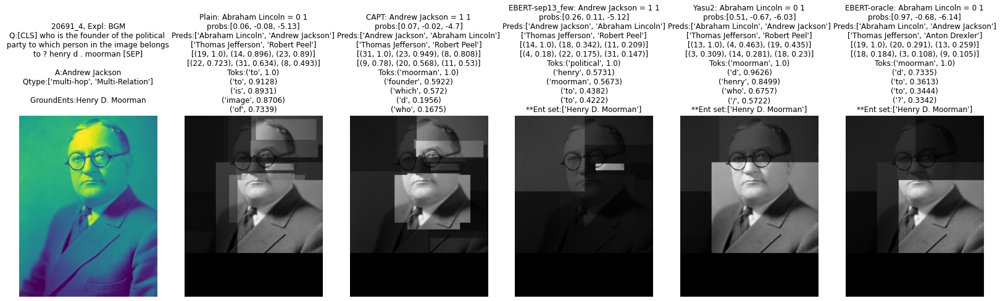

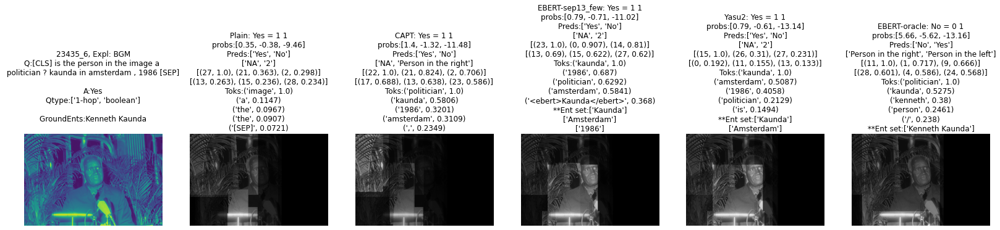

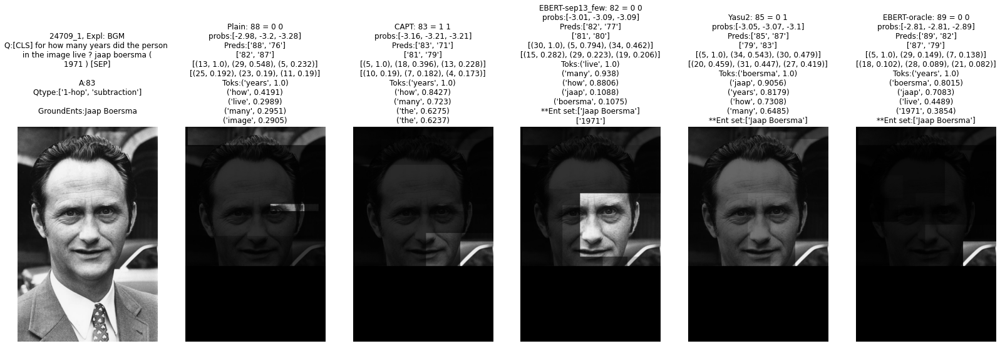

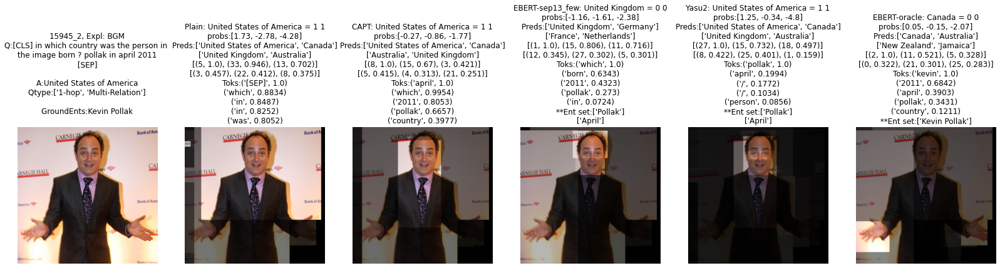

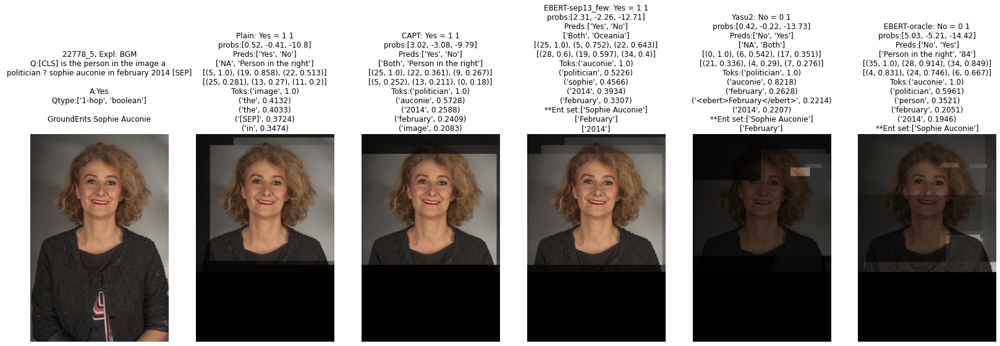

...

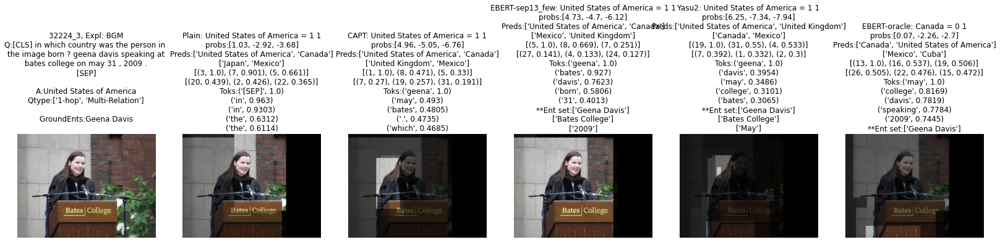

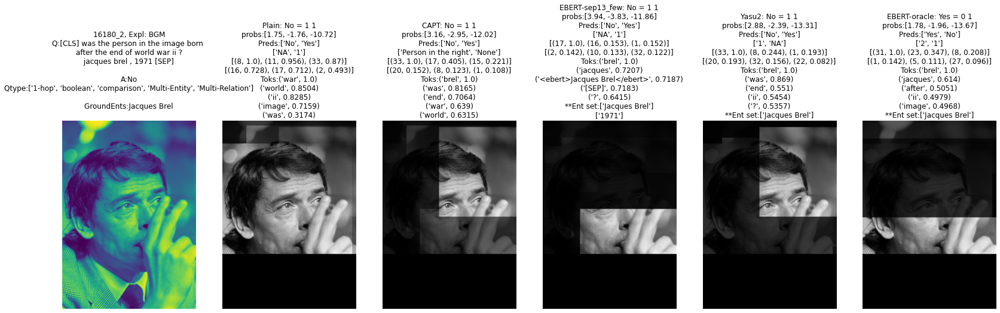

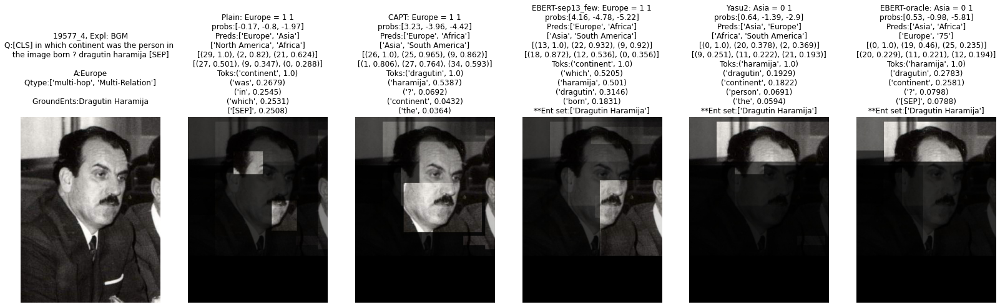

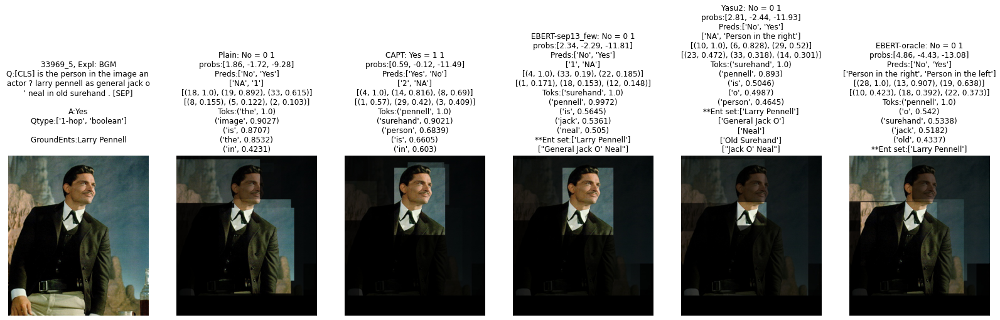

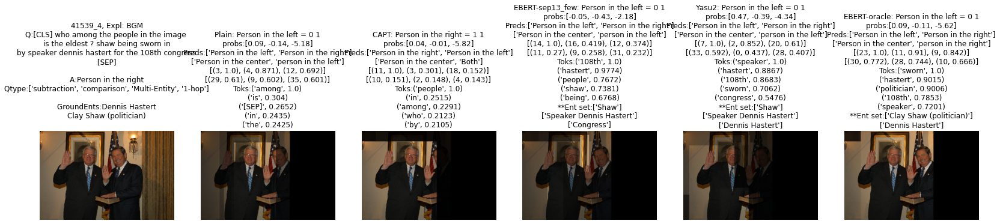

In [64]:
# SHOW examples of where ORACLE vs CAPT where EBERT results >  CAPT ones

"""
show_items_for_eval(fdf, res_set1, res_set1_wo, 
                    comp_str="EBERT-oracle vs CAPT", with_ents=True,  
                    cmp_type="gt", linktype="noisy", toshow = 50)
"""

# MAKE THIS ONLY INCLUDE CASES WHERE EBERT IN TOP 5   ... See how I did this with OKVQA 

#for TOP 5 imp we get
# XXXLooking at EBERT-oracle vs CAPT  for questions  with ent spans = 1065 out of  18697 0.057   <--- why is this number sooo low???   
# XXXEBERT-oracle better than  CAPT : 72 0.0039      <-- THIS WAS A BUG!! 
# XXXEBERT-oracle worse than  CAPT : 44 0.0024 
# XXXEBERT-oracle and equal to   CAPT : 949 0.0508

# for top 5
# Looking at EBERT-oracle vs CAPT  for questions  with ent spans = 962 out of  18697 0.0515   ## CONSISTENT wITH TABLE
# EBERT-oracle better than  CAPT : 63 0.0034 
# EBERT-oracle worse than  CAPT : 42 0.0022 
# EBERT-oracle and equal to   CAPT : 857 0.0458

# for top10
# Looking at EBERT-oracle vs CAPT  for questions  with ent spans = 4440 out of  18697 0.2375   # CONSISTENT wITH TABLE
# EBERT-oracle better than  CAPT : 323 0.0173 
# EBERT-oracle worse than  CAPT : 226 0.0121 
# EBERT-oracle and equal to   CAPT : 3891 0.2081

# for all ( topk = 200 )
# Looking at EBERT-oracle vs CAPT  for questions  with ent spans = 18594 out of  18697 0.9945
# EBERT-oracle better than  CAPT : 1475 0.0789 
# EBERT-oracle worse than  CAPT : 889 0.0475 
# EBERT-oracle and equal to   CAPT : 16230 0.8681 ( means both right or both wrong .. not that its the exact same pred )



show_items_for_eval(fdf, res_set1, res_set1_wo, 
                    comp_str="EBERT-oracle vs CAPT", with_ents=True,  
                    cmp_type="lt", linktype="noisy", toshow = 50)   #filter last 20 to only include 6 that are interesting


# REMAINING
#XXX 0. MAKE IT SO THAT YOU DON'T GET THE SAME IMAGE TWICE !! <-- since thats uninteresting
#1. MAKE THE 2 pdfs / SPREADSHEETS WITH TOPK=10  
#2. Show in how many questions KVQAmeta noisy pred differs from CAPT and how.. 
#3. Do without considering topk at all ( ie, put topk=200 ) .. make two pdfs / spreadsheets

#4. make table showing Oracle better , CAPT better ,  Oracle=CAPT for both topk=10  and topk=100 ( even if you don't end up using #3 pdfs )

print()

In [421]:
def construct_qt_table_res(fedf, to_print=False):
    qt_cols = ['Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection']
    qt_tabs = []
    qt_pct = []
    for m in ["Plain","CAPT"]:
        c = fedf[(fedf.model == m)].shape[0]
        cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")]
        if to_print:
            print("\n"+m,"1-hop",100 * round(cur.top1acc.mean(),4), round(100*cur.shape[0]/c,2))
        qt_pc = ["pct qs","with",round(100*cur.shape[0]/c,2)]
        qt_tab = [ m, "-", 100 * round(cur.top1acc.mean(),4) ]
        cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")]
        if to_print:
            print(m,"multi-hop",100 * round(cur.top1acc.mean(),4), round(100*cur.shape[0]/c,2),"\n")
        qt_pc.extend([round(100*cur.shape[0]/c,2)])
        qt_tab.extend([100 * round(cur.top1acc.mean(),4)])
        for qt in qt_cols:
            cur = fedf[(fedf.model == m) & (fedf[qt] == 1)]
            if to_print:
                print(m,qt,round(100*cur.top1acc.mean(),2), round(100*cur.shape[0]/c,2))
            qt_tab.extend([100 * round(cur.top1acc.mean(),4)])
            qt_pc.extend([round(100*cur.shape[0]/c,2)])
        
        if len(qt_pct) == 0:
            qt_pct = qt_pc
            qt_pc.extend([0])
            qt_tabs.append(qt_pc)
        qt_tab.extend([round(100 * fedf[(fedf.model == m)].top1acc.mean(),2)])
        qt_tabs.append(qt_tab)

    for m in ["EBERT-sep13_few","Yasu2", "EBERT-oracle"]:
        for lt in ["plain","links","noisy"]:
            c = fedf[(fedf.model == m)&(fedf.linktype==lt)].shape[0]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")&(fedf.linktype==lt)]
            if to_print:
                print("\n"+m,lt,"1-hop",100 * round(cur.top1acc.mean(),4), round(100*cur.shape[0]/c,2))
            qt_tab = [ m, lt, 100 * round(cur.top1acc.mean(),4) ]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")&(fedf.linktype==lt)]
            if to_print:
                print(m,lt,"multi-hop",100 * round(cur.top1acc.mean(),4), round(100*cur.shape[0]/c,2),"\n")
            qt_tab.extend([100 * round(cur.top1acc.mean(),4)])
            for qt in qt_cols:
                cur = fedf[(fedf.model == m) & (fedf[qt] == 1)&(fedf.linktype==lt)]
                if to_print:
                    print(m,lt, qt,round(100*cur.top1acc.mean(),2), round(100*cur.shape[0]/c,2))
                qt_tab.extend([100 * round(cur.top1acc.mean(),4)])
            qt_tab.extend([round(100 * fedf[(fedf.model == m)&(fedf.linktype==lt)].top1acc.mean(),2)])
            qt_tabs.append(qt_tab)
    qt_df = pd.DataFrame(qt_tabs, columns=["model","linktype","1-hop", "multi-hop", 'Multi-Relation', 'boolean', 
                                   'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection', 'Acc'])
    
    #add averages 
    qt_cols = ["1-hop", "multi-hop",'Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection','Acc']
    loc = ["Average", ""]
    for qt in qt_cols:
        loc.extend([round(qt_df[qt].values[1:12].mean(),2)])
    qt_df.loc[len(qt_df.index)] = loc
    
    return qt_df

st = time.time()
qt_pdf = construct_qt_table_res(fedf, to_print=False)
print("Done. Elapsed:",time.time() - st )  #11

Done. Elapsed: 7.5496721267700195


In [422]:
qt_pdf

,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc
0,pct qs,with,81.80,18.20,53.58,24.63,24.96,16.81,15.22,12.07,7.89,1.82,0.00
1,Plain,-,44.89,57.98,47.40,86.37,72.14,81.67,28.12,19.68,84.62,65.00,47.27
2,CAPT,-,46.36,65.47,51.57,87.21,72.46,80.91,29.17,19.33,85.03,70.29,49.84
3,EBERT-sep13_few,plain,46.21,65.47,51.83,86.45,72.12,80.85,28.54,18.93,84.76,67.94,49.72
4,EBERT-sep13_few,links,46.80,66.00,51.85,86.02,72.87,81.67,30.40,20.04,85.43,68.53,50.29
5,EBERT-sep13_few,noisy,46.68,65.35,51.58,86.13,73.02,82.09,29.21,20.83,85.30,65.88,50.08
6,Yasu2,plain,46.55,65.77,51.62,85.84,72.80,81.96,30.51,19.90,84.76,68.53,50.05
7,Yasu2,links,46.59,65.94,51.53,85.30,72.78,81.61,30.65,20.52,85.43,66.18,50.11
8,Yasu2,noisy,47.50,67.26,52.76,86.06,72.74,81.61,31.42,20.61,85.03,66.76,51.10
9,EBERT-oracle,plain,48.38,69.38,54.58,87.08,73.23,82.18,31.28,20.92,85.16,70.88,52.20


In [ ]:
# For all models they do worse at subtraction ( 12% of questions, avg acc 20.38 )
#                              at spatial     ( 15% of questions, avg acc 30.14 )
#                                 1-hop       ( 81.8% of questions, avg acc 47.06 )
# For all models they do best at  boolean  ( 24.6% of questions, avg acc 86.34 )
#                                counting  (  7.9% of questions, avg acc 85.09 )
#                              comparison  ( 16.8% of questions, avg acc 81.75 ) 

#so based on the above 1-hop and multi-hop see improvements of 2.52 and 6.08 points using EBERT-oracle compared with CAPT. 
#                                                               .44 and  .53 points using EBERT-few links
#                                                              1.14 and 1.79 points using Yasu2 noisy                                                              

# Multi-Relation sees improvement ( .28,  1.19, and 4.57 )   53.58%
# boolean does worse             (-1.19, -1.15, and -.58 )   24.63%   <--worse with entities
# Mult-entity   sees improvement  ( .41,   .28, and 1.11 )   24.96%	
# comparison    sees improvement  ( .76,   .70, and 1.24 )   16.81%
# spatial       sees improvement  (1.23,  2.25, and  .93 )   15.22%
# subtraction   sees improvement  ( .71,  1.28  and 1.90 )   12.97%
# counting      sees improvement  ( .40,   0    and  .67 )    7.89%
# intersection  does worse      ( -1.76, -3.53  and -.29 )    1.82%   <--- worse with entities 

#print(qt_pdf.to_latex(index=False, bold_rows=True))

In [414]:
#GET AVERAGE JUST OVER EBERT models
import pandas as pd
ebert_res_qt= [[46.55,65.77,51.62,85.84,72.80,81.96,30.51,19.90,84.76,68.53,50.05 ],
               [46.59,65.94,51.53,85.30,72.78,81.61,30.65,20.52,85.43,66.18,50.11 ],
               [47.50,67.26,52.76,86.06,72.74,81.61,31.42,20.61,85.03,66.76,51.10 ],
               [46.21,65.47,51.83,86.45,72.12,80.85,28.54,18.93,84.76,67.94,49.72 ],
               [46.80,66.00,51.85,86.02,72.87,81.67,30.40,20.04,85.43,68.53,50.29 ],
               [46.68,65.35,51.58,86.13,73.02,82.09,29.21,20.83,85.30,65.88,50.08 ],
               [48.38,69.38,54.58,87.08,73.23,82.18,31.28,20.92,85.16,70.88,52.20 ],
               [48.87,70.61,55.43,86.69,73.68,82.50,31.14,22.21,84.82,71.47,52.83 ],
               [48.88,71.55,56.14,86.63,73.57,82.15,31.14,21.23,85.70,70.00,53.01 ]]
qt_cols = ["1-hop", "multi-hop", 'Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection', 'Acc']
qt_df = pd.DataFrame(ebert_res_qt,columns=qt_cols)
#add averages 
loc = []
for qt in qt_cols:
    loc.extend([round(qt_df[qt].values.mean(),2)])
qt_df.loc[len(qt_df.index)] = loc
qt_df

,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc
0,46.55,65.77,51.62,85.84,72.80,81.96,30.51,19.90,84.76,68.53,50.05
1,46.59,65.94,51.53,85.30,72.78,81.61,30.65,20.52,85.43,66.18,50.11
2,47.50,67.26,52.76,86.06,72.74,81.61,31.42,20.61,85.03,66.76,51.10
3,46.21,65.47,51.83,86.45,72.12,80.85,28.54,18.93,84.76,67.94,49.72
4,46.80,66.00,51.85,86.02,72.87,81.67,30.40,20.04,85.43,68.53,50.29
5,46.68,65.35,51.58,86.13,73.02,82.09,29.21,20.83,85.30,65.88,50.08
6,48.38,69.38,54.58,87.08,73.23,82.18,31.28,20.92,85.16,70.88,52.20
7,48.87,70.61,55.43,86.69,73.68,82.50,31.14,22.21,84.82,71.47,52.83
8,48.88,71.55,56.14,86.63,73.57,82.15,31.14,21.23,85.70,70.00,53.01
9,47.38,67.48,53.04,86.24,72.98,81.85,30.48,20.58,85.15,68.46,51.04


In [423]:
# confidence by question type/ model
#fedf.columns
def construct_qt_conf_res(fedf, to_print=False):
    qt_cols = ['Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection']
    qt_tabs = []
    r = 2
    for m in ["Plain","CAPT"]:
        c = fedf[(fedf.model == m)].shape[0]
        cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")]
        conf = [ v[0] for v in cur.top5probs ]
        if to_print:
            print("\n"+m,"1-hop", round(np.mean(conf),r))
        qt_tab = [ m, "-", round(np.mean(conf),r) ]
        cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")]
        conf = [ v[0] for v in cur.top5probs ]
        if to_print:
            print(m,"multi-hop",round(np.mean(conf),r),"\n")
        qt_tab.extend([round(np.mean(conf),r)])
        for qt in qt_cols:
            cur = fedf[(fedf.model == m) & (fedf[qt] == 1)]
            conf = [ v[0] for v in cur.top5probs ]
            if to_print:
                print(m,qt,round(np.mean(conf),r))
            qt_tab.extend([round(np.mean(conf),r)])
        
        cur =  fedf[(fedf.model == m)]
        conf = [ v[0] for v in cur.top5probs ]
        qt_tab.extend([round(np.mean(conf),r)])
        qt_tab.extend([round(100 * fedf[(fedf.model == m)].top1acc.mean(),r)])
        qt_tabs.append(qt_tab)

    for m in ["EBERT-sep13_few","Yasu2", "EBERT-oracle"]:
        for lt in ["plain","links","noisy"]:
            c = fedf[(fedf.model == m)&(fedf.linktype==lt)].shape[0]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")&(fedf.linktype==lt)]
            conf = [ v[0] for v in cur.top5probs ]
            if to_print:
                print("\n"+m,lt,"1-hop",round(np.mean(conf),r))
            qt_tab = [ m, lt, round(np.mean(conf),r) ]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")&(fedf.linktype==lt)]
            conf = [ v[0] for v in cur.top5probs ]
            if to_print:
                print(m,lt,"multi-hop",round(np.mean(conf),r),"\n")
            qt_tab.extend([round(np.mean(conf),r)])
            for qt in qt_cols:
                cur = fedf[(fedf.model == m) & (fedf[qt] == 1)&(fedf.linktype==lt)]
                conf = [ v[0] for v in cur.top5probs ]
                if to_print:
                    print(m,lt, qt,round(np.mean(conf),r))
                qt_tab.extend([round(np.mean(conf),r)])
            cur =  fedf[(fedf.model == m)&(fedf.linktype==lt)]
            conf = [ v[0] for v in cur.top5probs ]
            qt_tab.extend([round(np.mean(conf),r)])   
            qt_tab.extend([round(100 * fedf[(fedf.model == m)&(fedf.linktype==lt)].top1acc.mean() ,r)])
            qt_tabs.append(qt_tab)
    qt_df = pd.DataFrame(qt_tabs, columns=["model","type","1-hop", "multi-hop", 'Multi-Relation', 'boolean', 
                                   'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection', 'Conf','Acc'])
    
    #add averages 
    qt_cols = ["1-hop", "multi-hop",'Multi-Relation', 'boolean', 'Multi-Entity', 
               'comparison', 'spatial', 'subtraction','counting', 'intersection','Conf','Acc']
    loc = ["Average", ""]
    for qt in qt_cols:
        ro = 2
        if qt == "Acc":
            ro = 4
        loc.extend([round(qt_df[qt].values[0:11].mean(),ro)])
    qt_df.loc[len(qt_df.index)] = loc
    return qt_df 

st = time.time()
qc_df = construct_qt_conf_res(fedf)
print("Done.Elapsed:",time.time() - st)
qc_df            #CONFIDENCE BY QUESTION TYPE

Done.Elapsed: 8.751713752746582


,model,type,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Conf,Acc
0,Plain,-,-0.01,1.32,0.05,3.20,2.21,2.89,-1.69,-1.79,5.57,1.76,0.23,47.2700
1,CAPT,-,0.50,2.70,1.00,4.26,3.15,3.85,-1.18,-1.83,5.97,3.52,0.90,49.8400
2,EBERT-sep13_few,plain,0.40,2.55,0.91,4.00,2.97,3.73,-1.28,-1.85,5.70,2.75,0.79,49.7200
3,EBERT-sep13_few,links,1.03,3.94,1.74,4.93,3.63,4.34,-0.71,-1.52,6.85,3.92,1.56,50.2900
4,EBERT-sep13_few,noisy,0.52,2.94,1.10,4.08,2.95,3.71,-1.25,-1.72,5.94,2.74,0.96,50.0800
5,Yasu2,plain,0.89,3.65,1.57,4.68,3.49,4.25,-0.73,-1.57,6.53,3.63,1.39,50.0500
6,Yasu2,links,0.98,3.54,1.61,4.88,3.61,4.40,-0.85,-1.58,6.90,3.67,1.45,50.1100
7,Yasu2,noisy,1.16,4.03,1.90,5.11,3.73,4.49,-0.67,-1.52,6.93,3.94,1.69,51.1000
8,EBERT-oracle,plain,1.25,4.07,2.05,5.16,3.82,4.59,-0.57,-1.56,6.95,3.93,1.76,52.2000
9,EBERT-oracle,links,1.08,4.26,1.99,4.65,3.54,4.16,-0.71,-1.52,6.86,3.54,1.66,52.8300


In [191]:
#print(qc_df.to_latex(index=False))

In [168]:
def construct_qt_conf_delta_res(fedf, to_print=False):
    qt_cols = ['Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection']
    qt_tabs = []
    for m in ["Plain","CAPT"]:
        c = fedf[(fedf.model == m)].shape[0]
        cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")]
        conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
        if to_print:
            print("\n"+m,"1-hop", round(np.mean(conf),4))
        qt_tab = [ m, "-", round(np.mean(conf),4) ]
        cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")]
        conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
        if to_print:
            print(m,"multi-hop",round(np.mean(conf),4),"\n")
        qt_tab.extend([round(np.mean(conf),4)])
        for qt in qt_cols:
            cur = fedf[(fedf.model == m) & (fedf[qt] == 1)]
            conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
            if to_print:
                print(m,qt,round(np.mean(conf),4))
            qt_tab.extend([round(np.mean(conf),4)])
        
        cur =  fedf[(fedf.model == m)]
        conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
        qt_tab.extend([round(np.mean(conf),4)])
        qt_tab.extend([round(fedf[(fedf.model == m)].top1acc.mean(),2)])
        qt_tabs.append(qt_tab)

    for m in ["EBERT-sep13_few","Yasu2", "EBERT-oracle"]:
        for lt in ["plain","links","noisy"]:
            c = fedf[(fedf.model == m)&(fedf.linktype==lt)].shape[0]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")&(fedf.linktype==lt)]
            conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
            if to_print:
                print("\n"+m,lt,"1-hop",round(np.mean(conf),4))
            qt_tab = [ m, lt, round(np.mean(conf),4) ]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")&(fedf.linktype==lt)]
            conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
            if to_print:
                print(m,lt,"multi-hop",round(np.mean(conf),4),"\n")
            qt_tab.extend([round(np.mean(conf),4)])
            for qt in qt_cols:
                cur = fedf[(fedf.model == m) & (fedf[qt] == 1)&(fedf.linktype==lt)]
                conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
                if to_print:
                    print(m,lt, qt,round(np.mean(conf),4))
                qt_tab.extend([round(np.mean(conf),4)])
            cur =  fedf[(fedf.model == m)&(fedf.linktype==lt)]
            conf = [ np.absolute(v[0]-v[1]) for v in cur.top5probs ]
            qt_tab.extend([round(np.mean(conf),4)])   
            qt_tab.extend([round(fedf[(fedf.model == m)&(fedf.linktype==lt)].top1acc.mean(),4)])
            qt_tabs.append(qt_tab)
    qt_df = pd.DataFrame(qt_tabs, columns=["model","type","1-hop", "multi-hop", 'Multi-Relation', 'boolean', 
                                   'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection', 'Conf','Acc'])
    
    #add averages 
    qt_cols = ["1-hop", "multi-hop",'Multi-Relation', 'boolean', 'Multi-Entity', 
               'comparison', 'spatial', 'subtraction','counting', 'intersection','Conf','Acc']
    loc = ["Average", ""]
    for qt in qt_cols:
        ro = 2
        if qt == "Acc":
            ro = 4
        loc.extend([round(qt_df[qt].values[1:12].mean(),ro)])
    qt_df.loc[len(qt_df.index)] = loc
    return qt_df 

st = time.time()
qd_df = construct_qt_conf_delta_res(fedf)
print("Done.Elapsed:",time.time() - st)
qd_df                                    #this Confidence Differential is not that interesting   XXXXX

Done.Elapsed: 15.730291843414307


,model,type,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Conf,Acc
0,Plain,-,3.4804,3.2575,3.2806,6.3966,4.9131,5.9205,1.2882,0.6364,11.1737,3.5840,3.4398,0.4700
1,CAPT,-,4.3233,6.0058,4.9063,8.3678,6.6638,7.6894,2.0332,0.7113,12.2143,6.9027,4.6295,0.5000
2,EBERT-sep13_few,plain,4.1511,5.7276,4.7591,7.8231,6.2887,7.4202,1.8674,0.6760,11.7939,5.4809,4.4380,0.4972
3,EBERT-sep13_few,links,5.1067,8.2597,6.1545,9.6841,7.5761,8.6545,2.5592,0.9151,13.6919,7.6018,5.6805,0.5029
4,EBERT-sep13_few,noisy,4.2206,6.3735,5.0219,7.9582,6.2010,7.3877,1.6944,0.6847,11.8895,5.3416,4.6125,0.5008
5,Yasu2,plain,4.9305,7.8139,5.9228,9.2853,7.3607,8.5369,2.5461,0.8393,13.5289,7.1444,5.4553,0.5005
6,Yasu2,links,5.0427,7.7217,5.9792,9.6417,7.5751,8.8033,2.3909,0.9059,13.6576,7.1547,5.5303,0.5011
7,Yasu2,noisy,5.3152,8.2606,6.3157,9.9730,7.7534,8.9032,2.6720,0.9511,14.0379,7.7103,5.8513,0.5110
8,EBERT-oracle,plain,5.4246,8.6235,6.6326,10.0916,7.9629,9.1264,2.8229,0.8842,13.9511,7.7515,6.0068,0.5220
9,EBERT-oracle,links,5.1745,9.2215,6.6499,9.2058,7.4476,8.3020,2.6393,0.9313,13.8824,7.1053,5.9111,0.5283


In [428]:
fedf.columns

Index(['qid', 'img_id', 'model', 'linktype', 'top1acc', 'top5acc', 'top5preds',
       'top5probs', 'true_ans', 'tokens', 'num_ents', 'ent_set',
       'text_expl_bgm', 'image_expl_bgm', 'text_expl_trf', 'image_expl_trf',
       'bboxes', 'tokens_whole', 'text_expl_bgm_whole', 'text_expl_trf_whole',
       'bgm_ent_imps', 'bgm_topent_imp', 'bgm_eberts_found', 'trf_ent_imps',
       'trf_topent_imp', 'trf_eberts_found', 'q_hops', 'Multi-Relation',
       'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction',
       'counting', 'intersection'],
      dtype='object')

In [115]:
def construct_ebert_imp_res(fedf, expl_col="bgm_topent_imp", k=5, to_print=False):
    qt_tabs = []
    qt_cols = ['Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection']
    for m in ["Yasu2","EBERT-sep13_few", "EBERT-oracle"]:
        for lt in ["plain","links","noisy"]:
            c = fedf[(fedf.model == m)&(fedf.linktype==lt)].shape[0]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")&(fedf.linktype==lt)&(fedf[expl_col] < k)&(fedf[expl_col] > -1)]
            qt_tab = [ m, lt, 100 * round(cur.top1acc.mean(),4) ]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")&(fedf.linktype==lt)&(fedf[expl_col] < k)&(fedf[expl_col] > -1)]
            qt_tab.extend([100 * round(cur.top1acc.mean(),4)])
            for qt in qt_cols:
                cur = fedf[(fedf.model == m) & (fedf[qt] == 1)&(fedf.linktype==lt)&(fedf[expl_col] < k)&(fedf[expl_col] > -1)]
                qt_tab.extend([100 * round(cur.top1acc.mean(),4)])
            qt_tab.extend([round(100 * fedf[(fedf.model == m)&(fedf.linktype==lt)&(fedf[expl_col] < k)&(fedf[expl_col] > -1)].top1acc.mean(),2)])
            qt_tab.extend([round(100 * fedf[(fedf.model == m)&(fedf.linktype==lt)&(fedf[expl_col] < k)&(fedf[expl_col] > -1)].shape[0] / fedf[(fedf.model == m)&(fedf.linktype==lt)].shape[0], 2 )])
            qt_tabs.append(qt_tab)
    qt_df = pd.DataFrame(qt_tabs, columns=["model","linktype","1-hop", "multi-hop", 'Multi-Relation', 'boolean', 
                                   'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection', 'Acc','Qs'])
    #add averages 
    qt_cols = ["1-hop", "multi-hop",'Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection','Acc','Qs']
    loc = ["Average", ""]
    for qt in qt_cols:
        loc.extend([round(qt_df[qt].values[0:9].mean(),2)])
    qt_df.loc[len(qt_df.index)] = loc    
    return qt_df

st = time.time()
#qe5_pdf = construct_ebert_imp_res(fedf, to_print=False)
qe5_pdf = construct_ebert_imp_res(fdf, k=5, to_print=False)
print("Done. Elapsed:",time.time() - st )  #11
qe5_pdf   # Bi-modal Generic Attention  ACCURACY WHEN EBERT IN TOP 5

Done. Elapsed: 6.82805323600769


,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc,Qs
0,Yasu2,plain,52.99,69.32,61.46,83.05,69.03,81.15,8.11,6.17,72.49,69.23,58.25,11.48
1,Yasu2,links,61.52,65.65,51.80,86.65,79.31,86.83,8.79,12.05,93.35,85.04,62.18,8.67
2,Yasu2,noisy,72.04,58.62,68.79,84.76,77.00,89.02,21.21,36.36,87.06,38.46,69.85,4.75
3,EBERT-sep13_few,plain,66.55,58.33,52.92,84.80,65.83,71.64,4.35,20.00,77.42,84.62,65.91,4.93
4,EBERT-sep13_few,links,50.45,61.72,51.34,87.14,78.59,89.21,2.96,20.00,83.29,70.65,52.74,14.75
5,EBERT-sep13_few,noisy,55.80,60.35,56.19,86.45,80.18,86.64,2.52,30.21,73.86,69.32,56.07,20.53
6,EBERT-oracle,plain,60.94,61.19,73.29,78.86,68.65,78.64,2.27,23.08,71.43,75.00,61.00,2.77
7,EBERT-oracle,links,70.36,62.32,73.54,82.83,76.40,84.34,2.38,21.43,60.67,83.33,68.97,4.26
8,EBERT-oracle,noisy,39.00,61.11,37.07,83.75,71.04,80.72,10.17,25.58,64.08,76.92,42.72,5.15
9,Average,,58.85,62.07,58.49,84.25,74.00,83.13,6.97,21.65,75.96,72.51,59.74,8.59


In [116]:
qe5_pdf = construct_ebert_imp_res(fdf, k=10, to_print=False)   # Bi-modal Generic Attention  ACCURACY WHEN EBERT IN TOP 10
#print(qe5_pdf.to_latex(index=False))
qe5_pdf

,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc,Qs
0,Yasu2,plain,44.38,66.78,54.28,82.38,65.95,79.88,6.02,7.69,68.95,73.02,51.40,31.23
1,Yasu2,links,49.07,66.64,49.16,84.46,73.83,84.60,6.27,9.58,85.74,81.96,52.86,33.32
2,Yasu2,noisy,60.56,60.70,56.07,86.30,73.88,84.41,11.98,21.43,89.43,63.11,60.59,21.62
3,EBERT-sep13_few,plain,51.27,58.05,50.24,85.12,71.66,81.00,2.35,10.92,79.59,79.70,52.14,19.60
4,EBERT-sep13_few,links,52.34,63.49,55.78,86.71,76.39,87.64,3.83,11.69,80.78,72.73,54.46,44.46
5,EBERT-sep13_few,noisy,51.32,57.93,50.54,85.46,73.84,83.58,2.77,25.00,77.19,68.85,52.16,44.94
6,EBERT-oracle,plain,51.63,62.26,67.49,79.15,64.34,73.50,4.07,25.00,64.98,74.73,55.12,8.52
7,EBERT-oracle,links,56.67,62.75,62.51,82.19,72.15,80.53,3.88,17.61,68.02,77.54,58.33,12.96
8,EBERT-oracle,noisy,38.99,63.54,41.81,82.60,69.59,81.83,5.42,16.72,70.18,63.38,43.58,23.75
9,Average,,50.69,62.46,54.21,83.82,71.29,81.89,5.18,16.18,76.10,72.78,53.40,26.71


In [117]:
st = time.time()
qe5t_pdf = construct_ebert_imp_res(fdf, expl_col="trf_topent_imp")
print("Done. Elapsed:",time.time() - st )  #11
qe5t_pdf   # Transformer Attention  ACCURACY WHEN EBERT IN TOP 5

Done. Elapsed: 6.808878421783447


,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc,Qs
0,Yasu2,plain,49.29,70.24,55.34,80.45,68.04,77.59,8.96,20.00,68.64,68.97,56.11,6.13
1,Yasu2,links,53.91,66.53,60.25,85.36,73.30,81.63,8.39,20.45,85.21,76.56,56.28,6.90
2,Yasu2,noisy,67.60,71.66,70.26,86.54,70.04,77.97,10.71,31.13,89.43,71.43,68.17,7.11
3,EBERT-sep13_few,plain,63.10,56.34,64.99,86.09,76.69,87.01,3.79,10.23,75.24,77.46,62.41,7.41
4,EBERT-sep13_few,links,44.59,65.72,48.94,89.53,69.68,81.95,5.22,16.75,82.24,82.05,49.31,18.52
5,EBERT-sep13_few,noisy,42.82,53.05,32.86,86.18,72.74,85.66,3.83,21.60,80.44,74.58,43.31,18.23
6,EBERT-oracle,plain,70.57,67.04,84.44,88.60,78.74,86.86,5.61,21.31,64.93,64.29,70.03,6.30
7,EBERT-oracle,links,81.13,64.39,87.35,90.77,87.28,91.76,5.71,16.22,53.27,86.21,79.67,12.57
8,EBERT-oracle,noisy,36.18,65.61,30.28,83.74,69.31,77.13,2.88,23.19,67.76,72.00,39.65,10.02
9,Average,,56.58,64.51,59.41,86.36,73.98,83.06,6.12,20.10,74.13,74.84,58.33,10.35


In [120]:
#print(qe5t_pdf.to_latex(index=False))
qe5t_pdf = construct_ebert_imp_res(fdf, expl_col="trf_topent_imp", k=10)  # Transformer Attention  ACCURACY WHEN EBERT IN TOP 10
qe5t_pdf

,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc,Qs
0,Yasu2,plain,46.09,68.86,54.51,82.35,68.54,81.17,6.02,10.77,69.59,75.23,52.96,22.64
1,Yasu2,links,44.70,61.24,48.00,82.30,66.59,76.53,8.09,14.39,77.45,72.73,48.44,25.24
2,Yasu2,noisy,53.25,66.40,47.26,86.02,67.15,78.58,7.30,22.26,87.19,69.84,55.14,23.38
3,EBERT-sep13_few,plain,47.76,61.73,52.46,85.18,73.52,84.85,3.98,7.08,79.44,76.44,50.20,28.32
4,EBERT-sep13_few,links,47.76,63.92,53.19,85.95,70.96,82.91,4.40,12.91,78.52,77.17,50.86,50.02
5,EBERT-sep13_few,noisy,47.14,58.22,42.20,84.79,70.28,81.48,2.97,24.77,81.33,73.06,48.28,40.95
6,EBERT-oracle,plain,52.46,70.91,69.80,87.60,70.12,81.37,5.94,23.00,62.26,78.09,57.15,15.56
7,EBERT-oracle,links,66.57,68.37,76.32,89.08,80.15,88.49,5.11,14.21,64.61,81.00,66.94,23.80
8,EBERT-oracle,noisy,38.23,68.13,39.57,82.97,68.64,79.89,4.79,13.36,73.61,65.46,42.88,36.19
9,Average,,49.33,65.31,53.70,85.14,70.66,81.70,5.40,15.86,74.89,74.34,52.54,29.57


In [110]:
bgm = qe5_pdf[["model","linktype","Acc","Qs"]]
trf = qe5t_pdf[["Acc","Qs"]]
findf = pd.concat([bgm,trf], axis=1)
findf.columns = ["model","link","BGM ACC", "BGM Qs", "TRF ACC", "TRF Qs"]
findf.model = [ mmap[m] if m in mmap else m for m in findf.model.values]
print(findf.to_latex(index=False))  #for top 5

\begin{tabular}{llrrrr}
\toprule
   model &  link &  BGM ACC &  BGM Qs &  TRF ACC &  TRF Qs \\
\midrule
  NERper & plain &    58.25 &   11.48 &    56.11 &    6.13 \\
  NERper & links &    62.18 &    8.67 &    56.28 &    6.90 \\
  NERper & noisy &    69.85 &    4.75 &    68.17 &    7.11 \\
 NERagro & plain &    65.91 &    4.93 &    62.41 &    7.41 \\
 NERagro & links &    52.74 &   14.75 &    49.31 &   18.52 \\
 NERagro & noisy &    56.07 &   20.53 &    43.31 &   18.23 \\
KVQAmeta & plain &    61.00 &    2.77 &    70.03 &    6.30 \\
KVQAmeta & links &    68.97 &    4.26 &    79.67 &   12.57 \\
KVQAmeta & noisy &    42.72 &    5.15 &    39.65 &   10.02 \\
 Average &       &    59.74 &    8.59 &    58.33 &   10.35 \\
\bottomrule
\end{tabular}



In [122]:
bgm = qe5_pdf[["model","linktype","Acc","Qs"]]
trf = qe5t_pdf[["Acc","Qs"]]
findf = pd.concat([bgm,trf], axis=1)
findf.columns = ["model","link","BGM ACC", "BGM Qs", "TRF ACC", "TRF Qs"]
findf.model = [ mmap[m] if m in mmap else m for m in findf.model.values]
print(findf.to_latex(index=False))
findf     #for top 10

\begin{tabular}{llrrrr}
\toprule
   model &  link &  BGM ACC &  BGM Qs &  TRF ACC &  TRF Qs \\
\midrule
  NERper & plain &    51.40 &   31.23 &    52.96 &   22.64 \\
  NERper & links &    52.86 &   33.32 &    48.44 &   25.24 \\
  NERper & noisy &    60.59 &   21.62 &    55.14 &   23.38 \\
 NERagro & plain &    52.14 &   19.60 &    50.20 &   28.32 \\
 NERagro & links &    54.46 &   44.46 &    50.86 &   50.02 \\
 NERagro & noisy &    52.16 &   44.94 &    48.28 &   40.95 \\
KVQAmeta & plain &    55.12 &    8.52 &    57.15 &   15.56 \\
KVQAmeta & links &    58.33 &   12.96 &    66.94 &   23.80 \\
KVQAmeta & noisy &    43.58 &   23.75 &    42.88 &   36.19 \\
 Average &       &    53.40 &   26.71 &    52.54 &   29.57 \\
\bottomrule
\end{tabular}



,model,link,BGM ACC,BGM Qs,TRF ACC,TRF Qs
0,NERper,plain,51.40,31.23,52.96,22.64
1,NERper,links,52.86,33.32,48.44,25.24
2,NERper,noisy,60.59,21.62,55.14,23.38
3,NERagro,plain,52.14,19.60,50.20,28.32
4,NERagro,links,54.46,44.46,50.86,50.02
5,NERagro,noisy,52.16,44.94,48.28,40.95
6,KVQAmeta,plain,55.12,8.52,57.15,15.56
7,KVQAmeta,links,58.33,12.96,66.94,23.80
8,KVQAmeta,noisy,43.58,23.75,42.88,36.19
9,Average,,53.40,26.71,52.54,29.57


In [205]:
#Look at General vs Top 5 for both
gt = pd.DataFrame([list(qt_pdf.loc[12].values), list(qe5_pdf.loc[9].values), list(qe5t_pdf.loc[9].values)], columns = qe5t_pdf.columns)
gt

,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc
0,Average,,47.06,66.43,52.39,86.34,72.86,81.75,30.14,20.38,85.09,68.31,50.59
1,Average,,58.72,63.84,58.87,85.61,76.83,82.90,33.97,35.71,83.31,72.51,51.04
2,Average,,56.58,66.38,59.50,87.29,76.68,82.88,29.07,30.58,82.87,72.92,51.04


In [208]:
qt_pdf.Acc.values[2:12].mean()

50.922999999999995

In [206]:
print(gt.to_latex(index=False))

\begin{tabular}{llrrrrrrrrrrr}
\toprule
  model & linktype &  1-hop &  multi-hop &  Multi-Relation &  boolean &  Multi-Entity &  comparison &  spatial &  subtraction &  counting &  intersection &   Acc \\
\midrule
Average &          &  47.06 &      66.43 &           52.39 &    86.34 &         72.86 &       81.75 &    30.14 &        20.38 &     85.09 &         68.31 & 50.59 \\
Average &          &  58.72 &      63.84 &           58.87 &    85.61 &         76.83 &       82.90 &    33.97 &        35.71 &     83.31 &         72.51 & 51.04 \\
Average &          &  56.58 &      66.38 &           59.50 &    87.29 &         76.68 &       82.88 &    29.07 &        30.58 &     82.87 &         72.92 & 51.04 \\
\bottomrule
\end{tabular}



In [195]:
def construct_ebert_imp_res_pct(fedf, expl_col="bgm_topent_imp", to_print=False):
    qt_cols = ['Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection']
    qt_tabs = []
    r = 2
    for m in ["EBERT-sep13_few","Yasu2", "EBERT-oracle"]:
        for lt in ["plain","links","noisy"]:
            c = fedf[(fedf.model == m)&(fedf.linktype==lt)&(fedf.q_hops == "1-hop")].shape[0]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "1-hop")&(fedf.linktype==lt)&(fedf[expl_col] < 5)&(fedf[expl_col] > -1)]        
            qt_tab = [ m, lt, round(100 * cur.shape[0]/c,r) ]
            cur = fedf[(fedf.model == m)&(fedf.q_hops == "multi-hop")&(fedf.linktype==lt)&(fedf[expl_col] < 5)&(fedf[expl_col] > -1)]
            c = fedf[(fedf.model == m)&(fedf.linktype==lt)&(fedf.q_hops == "multi-hop")].shape[0]
            qt_tab.extend([round(100 * cur.shape[0]/c,r)])
            for qt in qt_cols:
                c = fedf[(fedf.model == m) & (fedf[qt] == 1)&(fedf.linktype==lt)].shape[0]
                cur = fedf[(fedf.model == m) & (fedf[qt] == 1)&(fedf.linktype==lt)&(fedf[expl_col] < 5)&(fedf[expl_col] > -1)]
                qt_tab.extend([round(100*cur.shape[0]/c,r)])
            qt_tab.extend([round(100 * fedf[(fedf.model == m)&(fedf.linktype==lt)].top1acc.mean(),2)])
            qt_tabs.append(qt_tab)
    qt_df = pd.DataFrame(qt_tabs, columns=["model","linktype","1-hop", "multi-hop", 'Multi-Relation', 'boolean', 
                                   'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection', 'Acc'])
    
    #add averages 
    qt_cols = ["1-hop", "multi-hop",'Multi-Relation', 'boolean', 'Multi-Entity', 'comparison', 'spatial', 'subtraction','counting', 'intersection','Acc']
    loc = ["Average", ""]
    for qt in qt_cols:
        loc.extend([round(qt_df[qt].values[1:10].mean(),2)])
    qt_df.loc[len(qt_df.index)] = loc
    
    return qt_df

st = time.time()
#qe5_pct_pdf = construct_ebert_imp_res_pct(fedf, to_print=False)
print("Done. Elapsed:",time.time() - st )  #11
qe5_pct_pdf   # Bi-modal Generic Attention ( what pct have ents in top 5)  <--- WHERE DO EBERTS ACTUALLY INFLUENCE THINGS  ( THIS IS CONFUSING / NOT USEFUL )

Done. Elapsed: 5.9604644775390625e-05


,model,linktype,1-hop,multi-hop,Multi-Relation,boolean,Multi-Entity,comparison,spatial,subtraction,counting,intersection,Acc
0,EBERT-sep13_few,plain,5.55,2.12,2.69,10.51,3.84,4.49,3.97,1.60,4.74,3.24,49.72
1,EBERT-sep13_few,links,14.76,14.69,14.82,17.43,13.99,15.53,15.96,6.91,20.33,10.29,50.29
2,EBERT-sep13_few,noisy,23.87,5.52,26.06,41.32,39.37,51.70,13.64,10.68,5.28,17.94,50.08
3,Yasu2,plain,9.99,18.16,13.71,9.36,11.96,10.31,7.17,8.91,14.43,3.53,50.05
4,Yasu2,links,9.00,7.17,7.17,8.27,6.49,6.68,6.57,6.43,20.12,6.76,50.11
5,Yasu2,noisy,5.07,3.32,4.15,6.97,7.65,8.56,2.88,2.70,17.34,2.94,51.10
6,EBERT-oracle,plain,2.71,3.06,2.99,1.61,6.97,7.19,4.18,2.62,3.73,10.59,52.20
7,EBERT-oracle,links,4.50,3.17,3.88,9.47,7.52,8.65,3.20,2.17,3.52,2.94,52.83
8,EBERT-oracle,noisy,5.48,3.64,5.84,5.02,6.07,5.76,4.50,2.93,5.35,3.53,53.01
9,Average,,9.42,7.34,9.83,12.43,12.50,14.30,7.26,5.42,11.26,7.32,51.21


In [ ]:
# 2. B find examples where EBERT is actually influential!    
#      what if i only trained on cases with EBERT and then used another model for non EBERT?
#       -- is it possible the model is learning to discard the ebert reps in most cases since its not prevelant quite a bit?
#            --> if possible, moreso likely with OKVQA since with KVQA we always have at least 90% of questions with ent sets

def show_some_ebert_exs(df924, modstr= "EBERT-oracle", k = 1, to_show=3, predtype=1, include_qtypes=True):
    topk = get_topk_most_influential_examples(df924, modstr = modstr, k = k, to_show=0, tokens_col="tokens_whole")
    qtypes = ['Multi-Relation', 'boolean', 'Multi-Entity','comparison', 'spatial', 'subtraction', 'counting', 'intersection']
    topk_p = topk[topk.top1acc == predtype]
    capt_mean = df924[(df924.model == "CAPT") & ( df924.qid.isin(list(topk.qid.values)))].top1acc.mean()
    allqs = df924[(df924.model == "CAPT")].shape[0]
    allqs_with_ents = df924[(df924.model == modstr)&(df924.topent_imp > -1)].shape[0]
    
    print("Out of ", topk.shape[0], " influential examples (where ebert tag in top ",k, ") for ",modstr, 
          "from which ", allqs_with_ents, "of", allqs, "qs have ebert tags",round(allqs_with_ents/allqs,4),
          "\n\t showing non-boolean/comparison/counting ones where pred accuracy = ",predtype," = ",topk_p.shape[0],
          "\nFor CAPT model: these ",topk.shape[0]," examples have a top1acc of ", round(capt_mean,4))
    shown = 0
    
    tinds = np.random.choice(list(topk_p.index.values),to_show*10,replace=False)
    for ii, i in enumerate(tinds):  
        qts = []
        qtcond = True            
        if include_qtypes:
            for qt in qtypes:
                if topk_p.loc[i][qt] != 0:
                    qts.append(qt)
            qtcond = 'boolean' not in qts and 'comparison' not in qts and 'counting' not in qts   #all these tend to be binary or 5-tery
            
        if qtcond and topk_p.loc[i].top1acc == predtype and shown < to_show: 
            """
            print(topk_p.loc[i].qid,len(topk_p.loc[i].tokens_whole), topk_p.loc[i].tokens_whole,
                  "\n\t",len(topk_p.loc[i].text_expl_whole), topk_p.loc[i].text_expl_whole,
                  "\n\t",topk_p.loc[i].ent_imps,
                  "\n\t",topk_p.loc[i].q_hops,qts, 
                  "\n\t",topk_p.loc[i].top1acc,topk_p.loc[i].top5preds, topk_p.loc[i].true_ans, "\n")
            """
            print(topk_p.loc[i].qid, topk_p.loc[i].ent_imps, qts)
            
            show_kvqa_bimodal_expls_img(topk.loc[i].qid, df924, okfigsize=(25,5), tokens_col="tokens_whole", text_expl_col="text_expl_whole") 
            shown += 1